![Getting Started](melbourn.PNG)

#                                       selling of units Pricing Dataset, melbourn

### `This is Supervised Task (Regression) `

###  About Dataset

Context

This data was scraped from publicly available results posted every week from Domain.com.au, I've cleaned it as best I can, now it's up to make data analysis magic. The dataset includes Address, Type of Real estate, Suburb, Method of Selling, Rooms, Price, Real Estate Agent, Date of Sale and distance from C.B.D.

### About the project
- This is a machine learning project to predict unit/property selling price in Melbourn. 

- This project aims to answers question about how much a unit price would be if given information such as location, number of bedrooms, etc? This would help potential tenant and also the owner to get the best price of their units, comparable to the market value. 


### Content

There are 20 features with one unique ids (ads_id) and one target feature (monthly_rent)

-Suburb: Suburb

Address: Address

Rooms: Number of rooms

Price: Price in Australian dollars

Method:

- S - property sold;
- SP - property sold prior;
- PI - property passed in;
- PN - sold prior not disclosed;
- SN - sold not disclosed;
- NB - no bid;
- VB - vendor bid;
- W - withdrawn prior to auction;
- SA - sold after auction;
- SS - sold after auction price not disclosed.
- N/A - price or highest bid not available.
Type:

- br - bedroom(s);
- h - house,cottage,villa, semi,terrace;
- u - unit, duplex;
- t - townhouse;
- dev site - development site;
- o res - other residential.
- SellerG: Real Estate Agent

Date: Date sold

Distance: Distance from CBD in Kilometres

Regionname: General Region (West, North West, North, North east …etc)

Propertycount: Number of properties that exist in the suburb.

Bedroom2 : Scraped # of Bedrooms (from different source)

Bathroom: Number of Bathrooms

Car: Number of carspots

Landsize: Land Size in Metres

BuildingArea: Building Size in Metres

YearBuilt: Year the house was built

CouncilArea: Governing council for the area

Lattitude: Self explanitory

Longtitude: Self explanitory

- Inspiration
 in the past there was no easy way to understand whether certain unit pricing is making sense or not. With this dataset, I wanted to be able to answer the following questions:

- What are the biggest factor affecting the unit/rent pricing?
- here we want to analyze Mellbourne data to cover points:
- Which suburbs are the best to buy in?
- Which ones are value for money?
- Where's the expensive side of town?
- where should I buy a 2 bedroom unit?

### `Import Libraries`


In [394]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import re
import missingno
import plotly.express as px
import regex
import plotly.graph_objects as go
import joblib
## scopndary
from datasist.structdata import detect_outliers
from geopy.distance import geodesic

## sklearn -- preprocessing
from sklearn.model_selection import train_test_split,cross_val_predict, cross_val_score
from sklearn.preprocessing import PowerTransformer, OrdinalEncoder, PolynomialFeatures
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline, FeatureUnion
from sklearn.compose import ColumnTransformer
from sklearn_features.transformers import DataFrameSelector
from sklearn.preprocessing import StandardScaler,RobustScaler
from sklearn.impute import KNNImputer, SimpleImputer
from sklearn.preprocessing import OneHotEncoder

## sklearn -- models
from sklearn.linear_model import LinearRegression, SGDRegressor, Ridge, Lasso, ElasticNet
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import AdaBoostRegressor
from xgboost import XGBRegressor
from sklearn.naive_bayes import GaussianNB
import lightgbm
from sklearn.model_selection import cross_validate


## sklearn -- metrics
from sklearn.metrics import mean_squared_error,r2_score



from sklearn.svm import SVR

import warnings
warnings.filterwarnings('ignore')

import streamlit as st

###  <span style='color:green '> Step01>>__ Load the dataset And Data Understanding </span>

In [210]:
TRAIN_PATH = os.path.join(os.getcwd(),'Melbourne_housing_FULL.csv')
df = pd.read_csv(TRAIN_PATH)
df.head()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,...,1.0,1.0,126.0,NaN,NaN,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra City Council,-37.7996,144.9984,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,3067.0,...,2.0,1.0,0.0,NaN,NaN,Yarra City Council,-37.8114,145.0116,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019.0


In [211]:
## Create working datafram as a deep copy
df2= df.copy(deep = True)
df2.head()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,...,1.0,1.0,126.0,NaN,NaN,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra City Council,-37.7996,144.9984,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,3067.0,...,2.0,1.0,0.0,NaN,NaN,Yarra City Council,-37.8114,145.0116,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019.0


In [212]:
## Check info
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34857 entries, 0 to 34856
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Suburb         34857 non-null  object 
 1   Address        34857 non-null  object 
 2   Rooms          34857 non-null  int64  
 3   Type           34857 non-null  object 
 4   Price          27247 non-null  float64
 5   Method         34857 non-null  object 
 6   SellerG        34857 non-null  object 
 7   Date           34857 non-null  object 
 8   Distance       34856 non-null  float64
 9   Postcode       34856 non-null  float64
 10  Bedroom2       26640 non-null  float64
 11  Bathroom       26631 non-null  float64
 12  Car            26129 non-null  float64
 13  Landsize       23047 non-null  float64
 14  BuildingArea   13742 non-null  float64
 15  YearBuilt      15551 non-null  float64
 16  CouncilArea    34854 non-null  object 
 17  Lattitude      26881 non-null  float64
 18  Longti

In [213]:
## check numerical data analysis values describe
df2.describe().transpose().style.background_gradient(cmap='hot')

,count,mean,std,min,25%,50%,75%,max
Rooms,34857.000000,3.031012,0.969933,1.000000,2.000000,3.000000,4.000000,16.000000
Price,27247.000000,1050173.344955,641467.130105,85000.000000,635000.000000,870000.000000,1295000.000000,11200000.000000
Distance,34856.000000,11.184929,6.788892,0.000000,6.400000,10.300000,14.000000,48.100000
Postcode,34856.000000,3116.062859,109.023903,3000.000000,3051.000000,3103.000000,3156.000000,3978.000000
Bedroom2,26640.000000,3.084647,0.980690,0.000000,2.000000,3.000000,4.000000,30.000000
Bathroom,26631.000000,1.624798,0.724212,0.000000,1.000000,2.000000,2.000000,12.000000
Car,26129.000000,1.728845,1.010771,0.000000,1.000000,2.000000,2.000000,26.000000
Landsize,23047.000000,593.598993,3398.841946,0.000000,224.000000,521.000000,670.000000,433014.000000
BuildingArea,13742.000000,160.256400,401.267060,0.000000,102.000000,136.000000,188.000000,44515.000000
YearBuilt,15551.000000,1965.289885,37.328178,1196.000000,1940.000000,1970.000000,2000.000000,2106.000000


In [214]:
## check categorial data analysis values describe
df2.describe(include='O').transpose().style.background_gradient(cmap='hot')

,count,unique,top,freq
Suburb,34857,351,Reservoir,844
Address,34857,34009,5 Charles St,6
Type,34857,3,h,23980
Method,34857,9,S,19744
SellerG,34857,388,Jellis,3359
Date,34857,78,28/10/2017,1119
CouncilArea,34854,33,Boroondara City Council,3675
Regionname,34854,8,Southern Metropolitan,11836


##  <span style='color:green '> Step02-- EDA and Data Cleaning </span>

In [215]:
## Check dtypes
df2.dtypes

Suburb            object
Address           object
Rooms              int64
Type              object
Price            float64
Method            object
SellerG           object
Date              object
Distance         float64
Postcode         float64
Bedroom2         float64
Bathroom         float64
Car              float64
Landsize         float64
BuildingArea     float64
YearBuilt        float64
CouncilArea       object
Lattitude        float64
Longtitude       float64
Regionname        object
Propertycount    float64
dtype: object

#### Check the duplicate 

In [216]:
#check duplikat
df2.duplicated().sum()

1

In [217]:
#Dropping duplikat
df2.drop_duplicates(inplace=True)

In [218]:
df2.duplicated().sum()

0

In [219]:
df2.columns

Index(['Suburb', 'Address', 'Rooms', 'Type', 'Price', 'Method', 'SellerG',
       'Date', 'Distance', 'Postcode', 'Bedroom2', 'Bathroom', 'Car',
       'Landsize', 'BuildingArea', 'YearBuilt', 'CouncilArea', 'Lattitude',
       'Longtitude', 'Regionname', 'Propertycount'],
      dtype='object')

In [220]:
## Check Suburb feature
df2['Suburb'].unique()

array(['Abbotsford', 'Airport West', 'Albert Park', 'Alphington',
       'Altona', 'Altona North', 'Armadale', 'Ascot Vale', 'Ashburton',
       'Ashwood', 'Avondale Heights', 'Balaclava', 'Balwyn',
       'Balwyn North', 'Bentleigh', 'Bentleigh East', 'Box Hill',
       'Braybrook', 'Brighton', 'Brighton East', 'Brunswick',
       'Brunswick West', 'Bulleen', 'Burwood', 'Camberwell', 'Canterbury',
       'Carlton North', 'Carnegie', 'Caulfield', 'Caulfield North',
       'Caulfield South', 'Chadstone', 'Clifton Hill', 'Coburg',
       'Coburg North', 'Collingwood', 'Doncaster', 'Eaglemont',
       'Elsternwick', 'Elwood', 'Essendon', 'Essendon North', 'Fairfield',
       'Fitzroy', 'Fitzroy North', 'Flemington', 'Footscray', 'Glen Iris',
       'Glenroy', 'Gowanbrae', 'Hadfield', 'Hampton', 'Hampton East',
       'Hawthorn', 'Heidelberg Heights', 'Heidelberg West', 'Hughesdale',
       'Ivanhoe', 'Kealba', 'Keilor East', 'Kensington', 'Kew',
       'Kew East', 'Kooyong', 'Maidstone', 

In [221]:
df2['Suburb'].value_counts()

Reservoir          844
Bentleigh East     583
Richmond           552
Glen Iris          491
Preston            485
                  ... 
Belgrave             1
Cranbourne East      1
Yarra Glen           1
Olinda               1
Menzies Creek        1
Name: Suburb, Length: 351, dtype: int64

In [222]:
def fur(x):
    try:
       return x.replace(' ','_')
    except:
        return np.nan

In [223]:

df2['Suburb']= df2['Suburb'].apply(fur)
df2['Suburb']

0        Abbotsford
1        Abbotsford
2        Abbotsford
3        Abbotsford
4        Abbotsford
            ...    
34852    Yarraville
34853    Yarraville
34854    Yarraville
34855    Yarraville
34856    Yarraville
Name: Suburb, Length: 34856, dtype: object

In [224]:
df2['Suburb'].value_counts()

Reservoir          844
Bentleigh_East     583
Richmond           552
Glen_Iris          491
Preston            485
                  ... 
Belgrave             1
Cranbourne_East      1
Yarra_Glen           1
Olinda               1
Menzies_Creek        1
Name: Suburb, Length: 351, dtype: int64

In [225]:
df2['Suburb'].unique()

array(['Abbotsford', 'Airport_West', 'Albert_Park', 'Alphington',
       'Altona', 'Altona_North', 'Armadale', 'Ascot_Vale', 'Ashburton',
       'Ashwood', 'Avondale_Heights', 'Balaclava', 'Balwyn',
       'Balwyn_North', 'Bentleigh', 'Bentleigh_East', 'Box_Hill',
       'Braybrook', 'Brighton', 'Brighton_East', 'Brunswick',
       'Brunswick_West', 'Bulleen', 'Burwood', 'Camberwell', 'Canterbury',
       'Carlton_North', 'Carnegie', 'Caulfield', 'Caulfield_North',
       'Caulfield_South', 'Chadstone', 'Clifton_Hill', 'Coburg',
       'Coburg_North', 'Collingwood', 'Doncaster', 'Eaglemont',
       'Elsternwick', 'Elwood', 'Essendon', 'Essendon_North', 'Fairfield',
       'Fitzroy', 'Fitzroy_North', 'Flemington', 'Footscray', 'Glen_Iris',
       'Glenroy', 'Gowanbrae', 'Hadfield', 'Hampton', 'Hampton_East',
       'Hawthorn', 'Heidelberg_Heights', 'Heidelberg_West', 'Hughesdale',
       'Ivanhoe', 'Kealba', 'Keilor_East', 'Kensington', 'Kew',
       'Kew_East', 'Kooyong', 'Maidstone', 

In [384]:
## for Address feature
print(df['Address'].unique())

['68 Studley St' '85 Turner St' '25 Bloomburg St' ... '147A Severn St'
 '12/37 Stephen St' '3 Tarrengower St']


In [227]:
df2['Address'].value_counts(ascending=False).T

5 Charles St        6
25 William St       4
57 Bay Rd           3
14 Arthur St        3
16 Clyde St         3
                   ..
2/2 Nicholls Rd     1
17 Fraser St        1
11a Bewdley St      1
6/13 Ulupna Rd      1
3 Tarrengower St    1
Name: Address, Length: 34009, dtype: int64

In [228]:
def fur2(x):
    try:
       return '_'.join(x.lower().split(' ')[1:] )
    except:
        return np.nan

In [229]:
df2['Address']= df2['Address'].apply(fur2)
df2['Address'].value_counts()

barkly_st         148
high_st           127
toorak_rd          93
dandenong_rd       91
victoria_st        81
                 ... 
ardrie_rd           1
9_somers_av         1
brittingham_ct      1
parkview_ct         1
kingscote_wy        1
Name: Address, Length: 10834, dtype: int64

<Axes: >

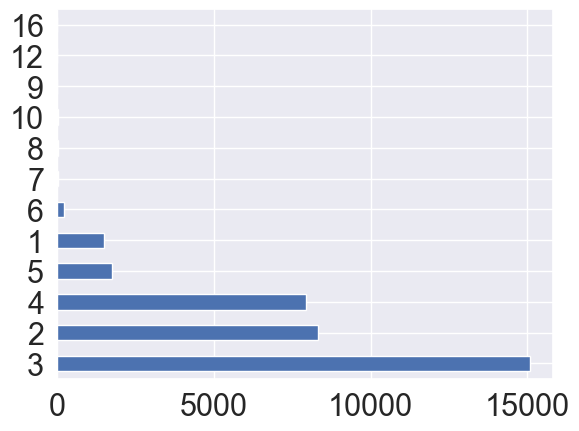

In [230]:
# Check Roons Feature
df2['Rooms'].value_counts().plot(kind= 'barh')

In [231]:
df2['Rooms'].value_counts()

3     15083
2      8332
4      7956
5      1737
1      1479
6       204
7        32
8        19
10        6
9         4
12        3
16        1
Name: Rooms, dtype: int64

In [232]:
df2['Rooms'].min()

1

<Axes: >

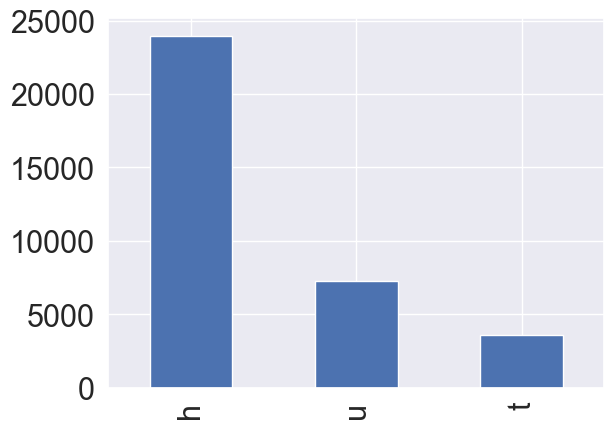

In [233]:
# Check Type Feature
df2['Type'].value_counts().plot(kind='bar')

In [234]:
df2['Type'].unique()

array(['h', 'u', 't'], dtype=object)

<Axes: xlabel='Price', ylabel='Count'>

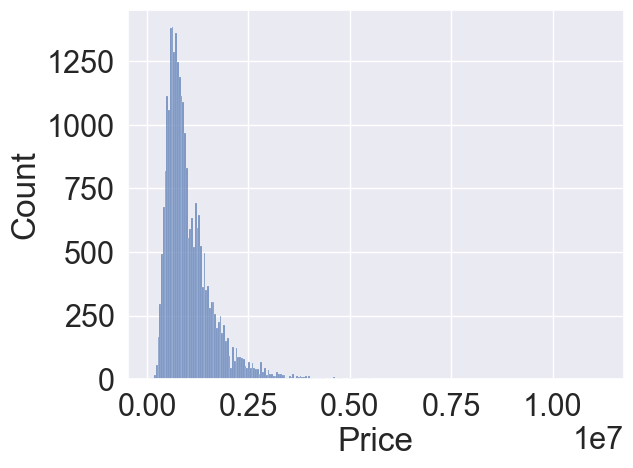

In [235]:
# Check Price 
sns.histplot(df2['Price'])

# There is askew

<Axes: >

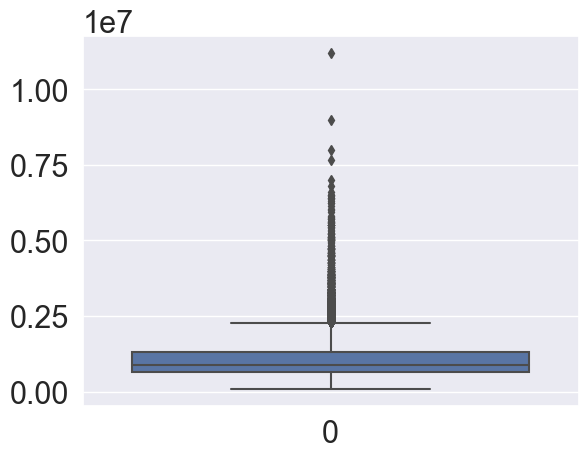

In [236]:
sns.boxplot(df2['Price'])

In [237]:
## Check Method
df2['Method'].value_counts()


S     19744
SP     5094
PI     4850
VB     3108
SN     1317
PN      308
SA      226
W       173
SS       36
Name: Method, dtype: int64

In [238]:
df2['Method'].unique()

array(['SS', 'S', 'VB', 'SP', 'PI', 'SN', 'W', 'PN', 'SA'], dtype=object)

In [239]:
## Check SellerG 
df2.rename(columns = {'SellerG':'Seller'}, inplace = True)
 

In [240]:
df2['Seller'].value_counts()

Jellis             3358
Nelson             3236
Barry              3235
hockingstuart      2623
Marshall           2027
                   ... 
Clairmont             1
Buxton/Find           1
Harcourts/Barry       1
Silver                1
Methven               1
Name: Seller, Length: 388, dtype: int64

In [241]:
df2['Seller'].unique()

array(['Jellis', 'Biggin', 'Rounds', 'Nelson', 'Collins', 'Dingle',
       'Purplebricks', 'Greg', 'Philip', 'LITTLE', 'Kay', 'Beller',
       'Marshall', 'hockingstuart', 'Brad', 'Maddison', 'Barry',
       'Airport', 'Considine', 'Rendina', 'Ray', 'Propertyau', 'McDonald',
       'Frank', 'Prof.', 'Harcourts', 'Thomson', 'Buxton', 'RT',
       "Sotheby's", 'Cayzer', 'Chisholm', 'McGrath', 'Brace', 'Miles',
       'Holland', 'Love', 'Thomas', 'Barlow', 'Sweeney', 'Village', 'Jas',
       'Williams', 'Gunn&Co', 'Burnham', 'Point', 'Compton', 'FN',
       'Hunter', 'Raine&Horne', 'Noel', 'Hodges', 'Gary', 'Fletchers',
       'Woodards', 'Raine', 'Alexkarbon', 'Walshe', 'Weda', 'Stockdale',
       'Tim', 'Buxton/Marshall', 'AIME', 'Moonee', 'HAR', 'Edward', 'RW',
       'North', 'MICM', 'Ascend', 'Christopher', 'Morrison', 'Bekdon',
       'Mandy', 'R&H', 'Fletchers/One', 'Lindellas', 'Appleby', 'Assisi',
       'One', 'Owen', 'Parkes', 'C21', 'Century', "O'Brien", 'Bayside',
       'And

In [242]:
## Check date columns
df2['Date']

0         3/09/2016
1         3/12/2016
2         4/02/2016
3         4/02/2016
4         4/03/2017
            ...    
34852    24/02/2018
34853    24/02/2018
34854    24/02/2018
34855    24/02/2018
34856    24/02/2018
Name: Date, Length: 34856, dtype: object

In [243]:
df2['Date']=pd.to_datetime(df2["Date"])

<Axes: >

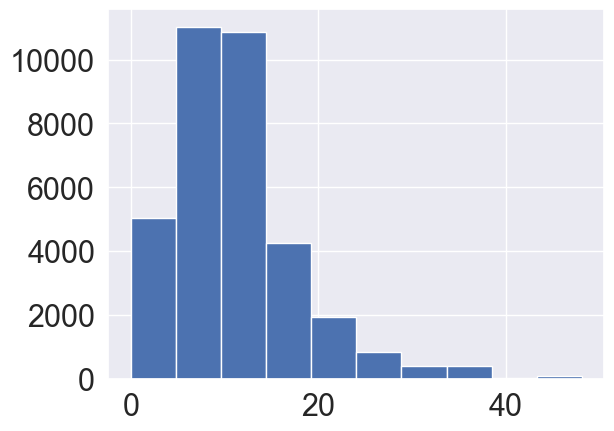

In [244]:
## Check Distance 
df2['Distance'].hist()

In [245]:
ids_wrong = df2[(df2['Distance']<=df2['Distance'].min())].index.tolist()
df2.drop(index=ids_wrong, axis=0, inplace=True)

<Axes: >

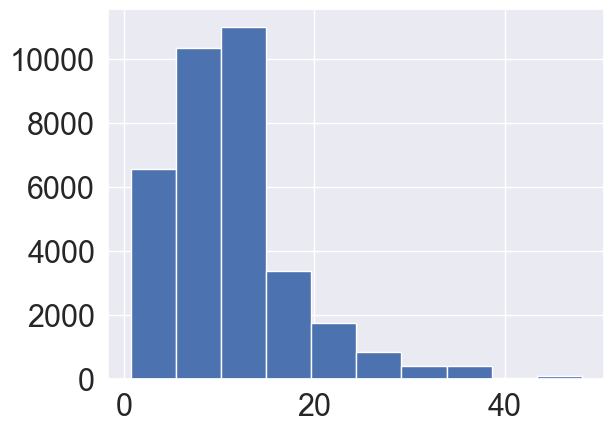

In [246]:
df2['Distance'].hist()

In [247]:
## Check bedrooms
df2['Bedroom2']= df2.rename(columns={'Bedroom2':'Two_bedroom_unit'}, inplace=True)

<Axes: >

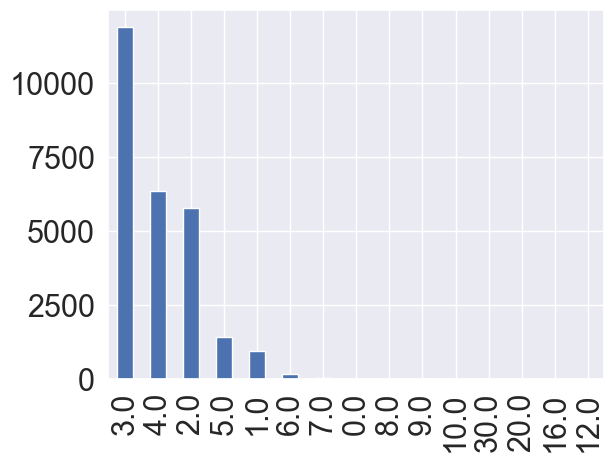

In [248]:
df2['Two_bedroom_unit'].value_counts().plot(kind='bar')

<Axes: >

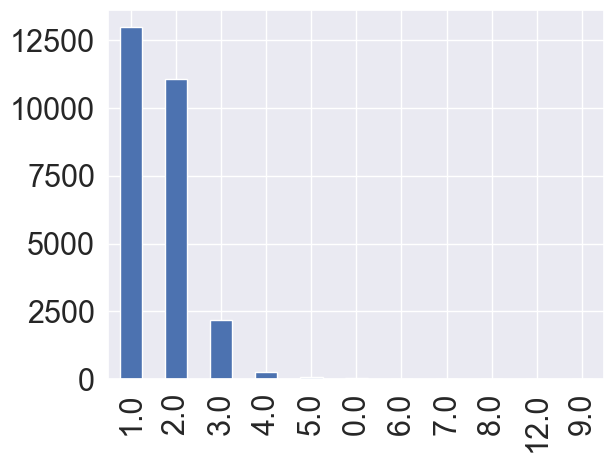

In [249]:
## Check bathrooms
df2['Bathroom'].value_counts().plot(kind='bar')

<Axes: >

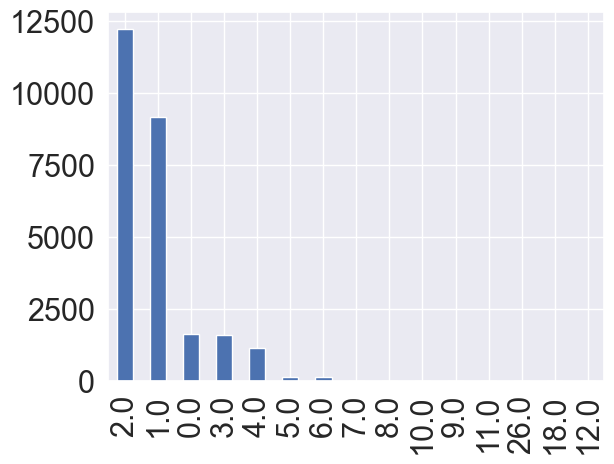

In [250]:
# check Car
df2['Car'].value_counts().plot(kind='bar')

<Axes: >

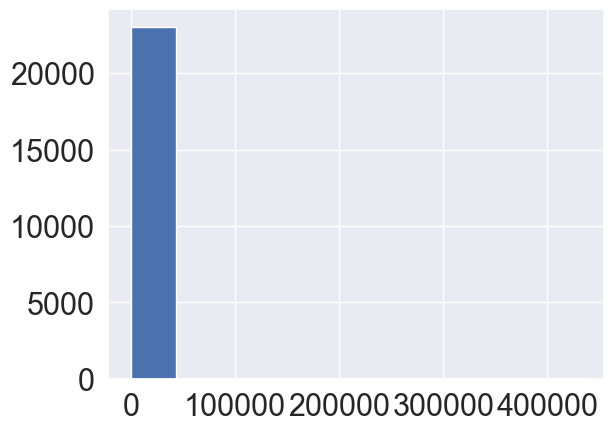

In [251]:
## Check Landsize
df2['Landsize'].hist()

In [252]:
df2['Landsize'].max(),df2['Landsize'].min()

(433014.0, 0.0)

In [253]:
df2['Landsize']

0        126.0
1        202.0
2        156.0
3          0.0
4        134.0
         ...  
34852    593.0
34853     98.0
34854    220.0
34855      NaN
34856    250.0
Name: Landsize, Length: 34779, dtype: float64

In [254]:
ids_wrong = df2[(df2['Landsize']==0.0)|(df2['Landsize']==df2['Landsize'].max())].index.tolist()
df2.drop(index=ids_wrong, axis=0, inplace=True)

<Axes: >

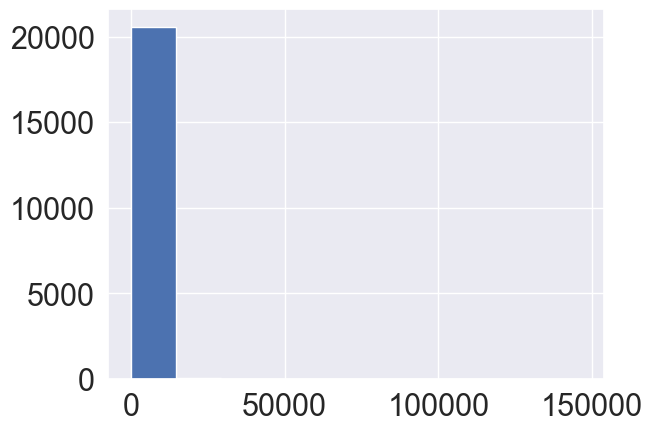

In [255]:
df2['Landsize'].hist()

In [256]:

ids_wrong = df2[(df2['Landsize']<=10.0)|(df2['Landsize']>=5000)].index.tolist()
df2.drop(index=ids_wrong, axis=0, inplace=True)

<Axes: >

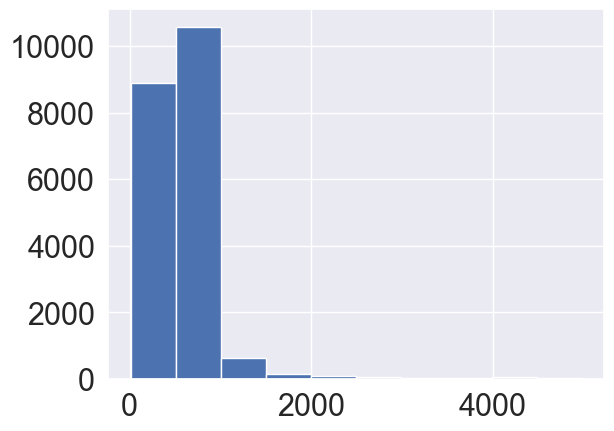

In [257]:
df2['Landsize'].hist()

<Axes: >

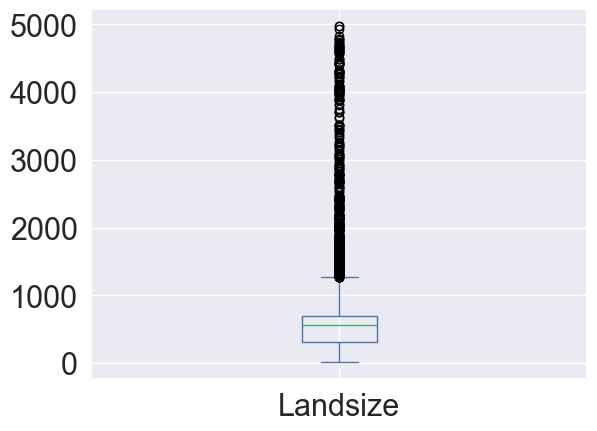

In [258]:
df2['Landsize'].plot(kind='box')

<Axes: >

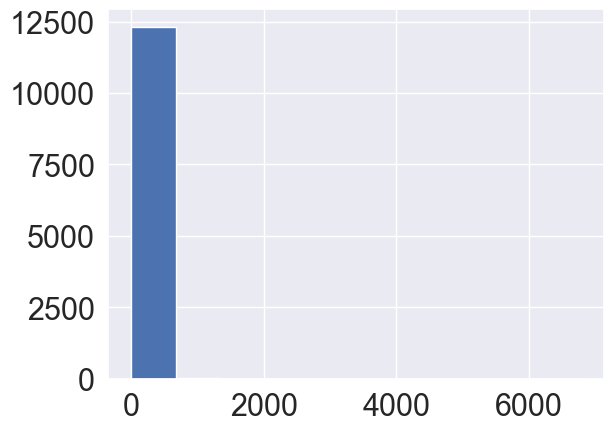

In [259]:
# Check Building Area
df2['BuildingArea'].hist()

<Axes: >

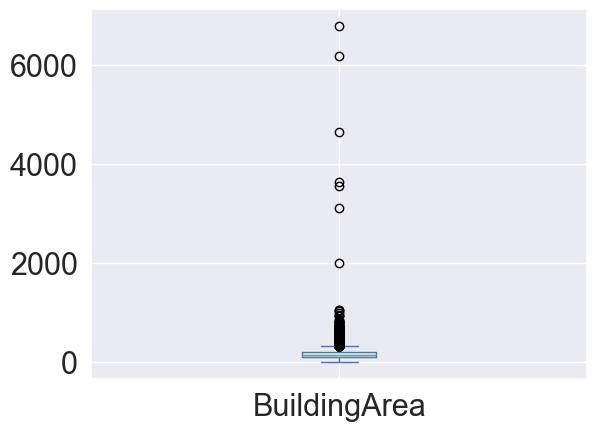

In [260]:
df2['BuildingArea'].plot(kind='box')

In [261]:
ids_wrong = df2[(df2['Landsize']<=0.0)].index.tolist()
df2.drop(index=ids_wrong, axis=0, inplace=True)

<Axes: >

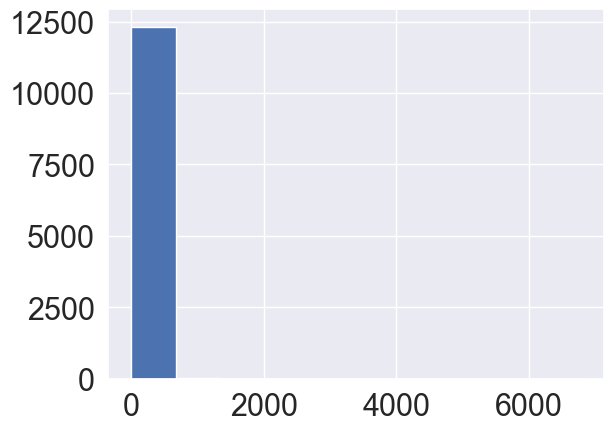

In [262]:
# Check Building area
df2['BuildingArea'].hist()

In [263]:
# Check CouncilArea
df2['CouncilArea'].value_counts()

Boroondara City Council           3403
Darebin City Council              2698
Moreland City Council             1972
Banyule City Council              1830
Glen Eira City Council            1814
Bayside City Council              1679
Moonee Valley City Council        1657
Brimbank City Council             1580
Monash City Council               1444
Melbourne City Council            1361
Maribyrnong City Council          1317
Hume City Council                 1208
Stonnington City Council          1195
Manningham City Council           1030
Yarra City Council                 998
Port Phillip City Council          997
Hobsons Bay City Council           902
Kingston City Council              854
Whittlesea City Council            828
Wyndham City Council               624
Whitehorse City Council            610
Maroondah City Council             504
Knox City Council                  371
Greater Dandenong City Council     313
Melton City Council                291
Frankston City Council   

In [264]:
def fur3(x):
    try:
       return x.split(' ')[0]
    except:
        return np.nan

In [265]:
df2['CouncilArea']= df2['CouncilArea'].apply(fur3)
df2['CouncilArea'].value_counts()

Boroondara     3403
Darebin        2698
Moreland       1972
Banyule        1830
Glen           1814
Bayside        1679
Moonee         1657
Brimbank       1580
Monash         1444
Melbourne      1361
Maribyrnong    1317
Hume           1208
Stonnington    1195
Yarra          1097
Manningham     1030
Port            997
Hobsons         902
Kingston        854
Whittlesea      828
Wyndham         624
Whitehorse      610
Maroondah       504
Knox            371
Greater         313
Melton          291
Frankston       288
Casey           176
Nillumbik        88
Cardinia         40
Macedon          37
Mitchell         19
Moorabool         6
Name: CouncilArea, dtype: int64

In [266]:
df2['CouncilArea'].unique()

array(['Yarra', 'Moonee', 'Port', 'Darebin', 'Hobsons', 'Stonnington',
       'Boroondara', 'Monash', 'Glen', 'Whitehorse', 'Maribyrnong',
       'Bayside', 'Moreland', 'Manningham', 'Melbourne', 'Banyule',
       'Brimbank', 'Kingston', 'Hume', 'Knox', 'Maroondah', 'Casey',
       'Melton', 'Greater', 'Nillumbik', 'Cardinia', 'Whittlesea',
       'Frankston', 'Macedon', 'Wyndham', 'Moorabool', 'Mitchell', nan],
      dtype=object)

In [267]:
# Check Region Name
df2['Regionname'].value_counts()

Southern Metropolitan         10444
Northern Metropolitan          8749
Western Metropolitan           6474
Eastern Metropolitan           4316
South-Eastern Metropolitan     1722
Eastern Victoria                221
Northern Victoria               193
Western Victoria                114
Name: Regionname, dtype: int64

In [268]:
df2['Regionname'].unique()

array(['Northern Metropolitan', 'Western Metropolitan',
       'Southern Metropolitan', 'Eastern Metropolitan',
       'South-Eastern Metropolitan', 'Eastern Victoria',
       'Northern Victoria', 'Western Victoria', nan], dtype=object)

In [269]:
def fur4(x):
    try:
       return x.split(' ')[1]
    except:
        return np.nan

In [270]:
df2['Region']= df2['Regionname'].apply(fur4)
df2['Region'].value_counts()

Metropolitan    31705
Victoria          528
Name: Region, dtype: int64

In [271]:
def fur5(x):
    try:
       return x.split(' ')[0]
    except:
        return np.nan

In [272]:
df2['District']= df2['Regionname'].apply(fur5)
df2['District'].value_counts()

Southern         10444
Northern          8942
Western           6588
Eastern           4537
South-Eastern     1722
Name: District, dtype: int64

<Axes: >

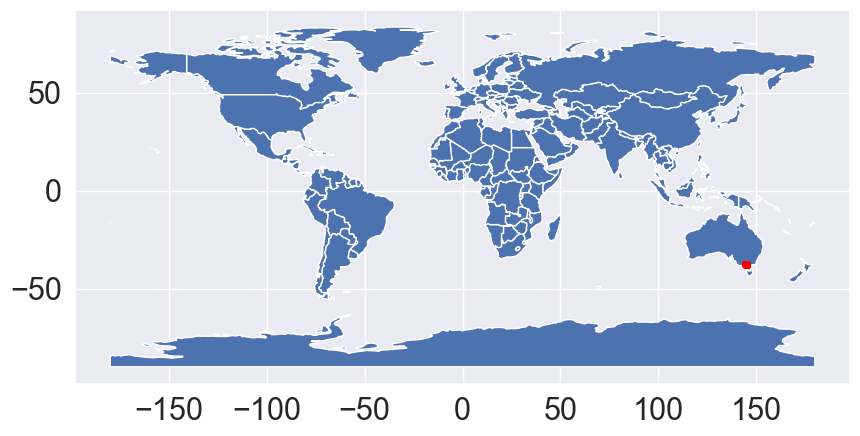

In [273]:
## for latitude and latitude feature
import pandas as pd
from shapely.geometry import Point
import geopandas as gpd
from geopandas import GeoDataFrame


geometry = [Point(xy) for xy in zip(df2['Longtitude'], df2['Lattitude'])]
gdf = GeoDataFrame(df2, geometry=geometry)   

#this is a simple map that goes with geopandas
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
gdf.plot(ax=world.plot(figsize=(10, 6)), marker='o', color='red', markersize=15)

<Axes: >

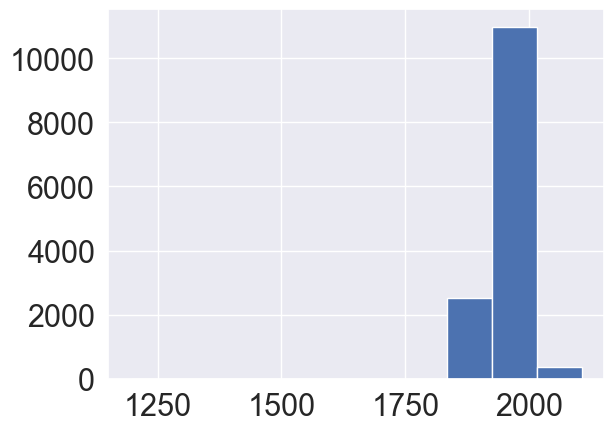

In [274]:
# Check Year Bulttry
df2['YearBuilt'].hist()

In [275]:
df2['YearBuilt'].value_counts()

1970.0    1125
1960.0    1088
1950.0    1048
1980.0     672
1900.0     585
          ... 
1883.0       1
1830.0       1
1884.0       1
1868.0       1
1879.0       1
Name: YearBuilt, Length: 159, dtype: int64

#  <span style='color:green '> Step02-- Feature Engineering </span>

####  `adjusted the Date  feature---->> Get month and Year`

In [276]:
# For Date  feature---->> Get month and Year
df2['Month']=df2['Date'].dt.month
df2['Year']=df2['Date'].dt.year

<Axes: >

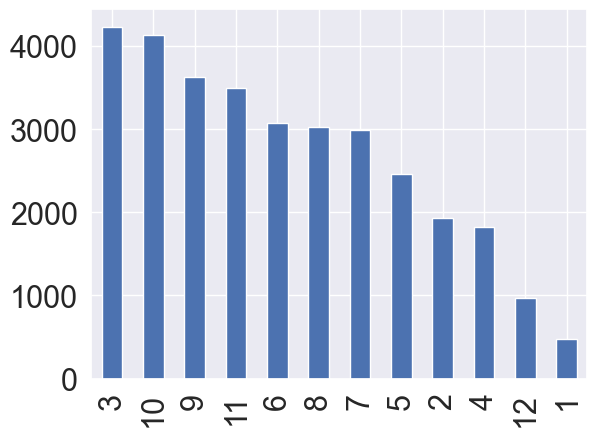

In [277]:
df2['Month'].value_counts().plot(kind='bar')


<Axes: >

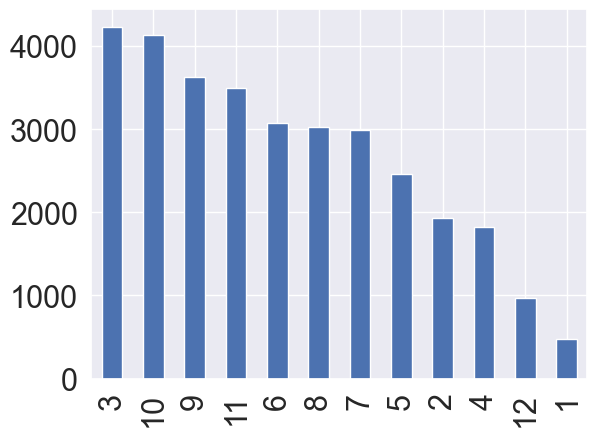

In [278]:
df2['Month'].value_counts().plot(kind='bar')


####  `adjusted the Price  feature---->> Get Kilo for all prices`

In [279]:
# Devided by 1000 to reduce the range
#df2['Price']=df2['Price']/1000
df2['Price'].max(),df2['Price'].min()


    

(11200.0, 112.0)

<Axes: >

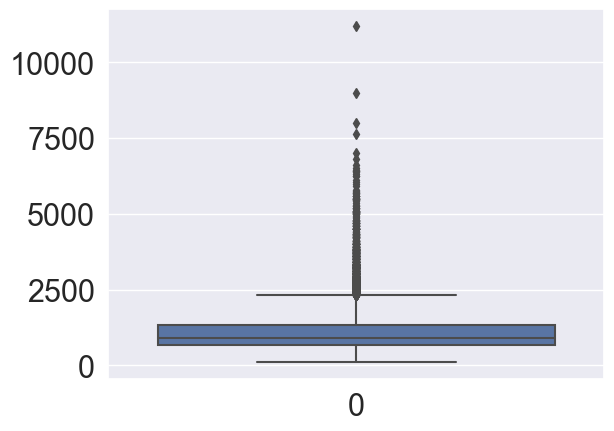

In [280]:
sns.boxplot(df2['Price'])

####  `get pricet per m2`

In [281]:
# get price per m2
df2['price_per_m2']= (df2['Price']*1000)/df2['Landsize']
df2['price_per_m2']

0                 NaN
1         7326.732673
2         6634.615385
4        10932.835821
5         9042.553191
             ...     
34852     2495.784148
34853     9061.224490
34854     3204.545455
34855             NaN
34856     4080.000000
Name: price_per_m2, Length: 32236, dtype: float64

In [282]:
# 'rent_per_m2' in Reservoir subrub
price_per_m2= (df2['price_per_m2'][df2['Suburb']== 'Reservoir']).mean()
price_per_m2

1831.7374335683314

In [283]:
df2['price_per_m2'].min(),df2['price_per_m2'].max()

(70.92626079967852, 97533.33333333333)

####  `lower case of all categories`

In [284]:
df2= df2.applymap(lambda s:s.lower() if type(s) == str else s)

####  `get the total area`

In [285]:
#cols = [ 'BuildingArea','Landsize']
#X = df2[cols]
#impute_knn = SimpleImputer(strategy='median')
#T=impute_knn.fit_transform(X)
#dt = pd.DataFrame(T, columns = ['BuildingArea','Landsize'])
#df2['BuildingArea']= dt['BuildingArea']
#df2['Landsize']= dt['Landsize']




In [286]:
#df2['total_area']= df2['BuildingArea']+df2['Landsize']
#df2.drop(df2[['BuildingArea','Landsize']], axis=1, inplace=True)


####  `get the building age`

In [287]:
from datetime import datetime

current_year = float(datetime.now().year)


In [288]:
df2['Bulding_Age']= current_year-df2['YearBuilt']

In [289]:
df2.columns

Index(['Suburb', 'Address', 'Rooms', 'Type', 'Price', 'Method', 'Seller',
       'Date', 'Distance', 'Postcode', 'Two_bedroom_unit', 'Bathroom', 'Car',
       'Landsize', 'BuildingArea', 'YearBuilt', 'CouncilArea', 'Lattitude',
       'Longtitude', 'Regionname', 'Propertycount', 'Bedroom2', 'Region',
       'District', 'Month', 'Year', 'price_per_m2', 'Bulding_Age'],
      dtype='object')

In [290]:
df2['Propertycount']

0        4019.0
1        4019.0
2        4019.0
4        4019.0
5        4019.0
          ...  
34852    6543.0
34853    6543.0
34854    6543.0
34855    6543.0
34856    6543.0
Name: Propertycount, Length: 32236, dtype: float64

#  <span style='color:green '> Step03-- Check nans </span>

In [291]:
(df2.isna().sum().sort_values(ascending= False)/ df2.shape[0])*100

Bedroom2            100.000000
BuildingArea         61.663978
YearBuilt            56.951855
Bulding_Age          56.951855
price_per_m2         50.518054
Landsize             36.422013
Car                  26.833354
Bathroom             25.310212
Two_bedroom_unit     25.282293
Lattitude            24.525375
Longtitude           24.525375
Price                21.938206
District              0.009306
Region                0.009306
Propertycount         0.009306
Regionname            0.009306
CouncilArea           0.009306
Postcode              0.003102
Distance              0.003102
Method                0.000000
Type                  0.000000
Address               0.000000
Rooms                 0.000000
Date                  0.000000
Month                 0.000000
Year                  0.000000
Seller                0.000000
Suburb                0.000000
dtype: float64

In [292]:
## Drop price nans
df2.dropna(subset=['Price'], inplace=True)


In [293]:
(df2.isna().sum().sort_values(ascending= False)/ df2.shape[0])*100

Bedroom2            100.000000
BuildingArea         62.060881
YearBuilt            57.319981
Bulding_Age          57.319981
price_per_m2         36.611826
Landsize             36.611826
Car                  26.891591
Bathroom             25.421237
Two_bedroom_unit     25.397393
Longtitude           24.650294
Lattitude            24.650294
District              0.011922
Regionname            0.011922
Region                0.011922
CouncilArea           0.011922
Propertycount         0.011922
Postcode              0.003974
Distance              0.003974
Month                 0.000000
Rooms                 0.000000
Year                  0.000000
Price                 0.000000
Method                0.000000
Type                  0.000000
Address               0.000000
Date                  0.000000
Seller                0.000000
Suburb                0.000000
dtype: float64

<Axes: >

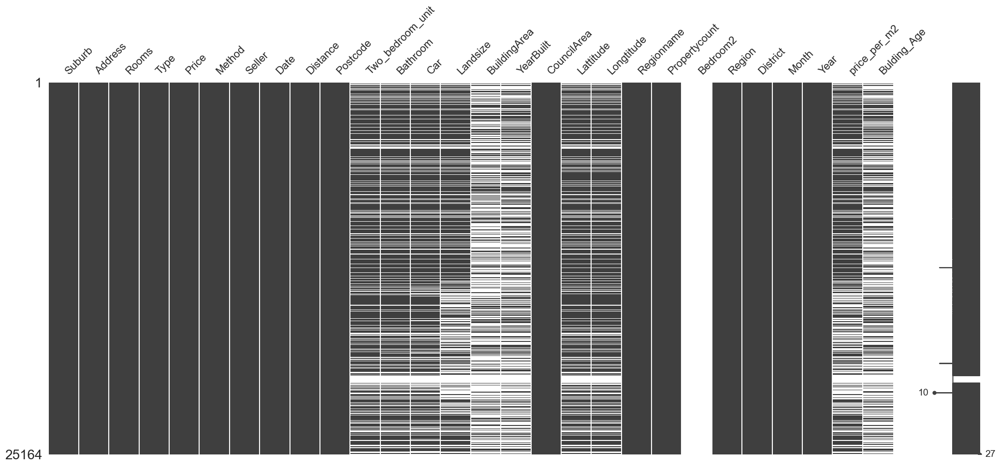

In [294]:
missingno.matrix(df2)


In [295]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 25164 entries, 1 to 34856
Data columns (total 28 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   Suburb            25164 non-null  object        
 1   Address           25164 non-null  object        
 2   Rooms             25164 non-null  int64         
 3   Type              25164 non-null  object        
 4   Price             25164 non-null  float64       
 5   Method            25164 non-null  object        
 6   Seller            25164 non-null  object        
 7   Date              25164 non-null  datetime64[ns]
 8   Distance          25163 non-null  float64       
 9   Postcode          25163 non-null  float64       
 10  Two_bedroom_unit  18773 non-null  float64       
 11  Bathroom          18767 non-null  float64       
 12  Car               18397 non-null  float64       
 13  Landsize          15951 non-null  float64       
 14  BuildingArea      9547

#  <span style='color:green '> Step04-->> Data Vizulization </span>

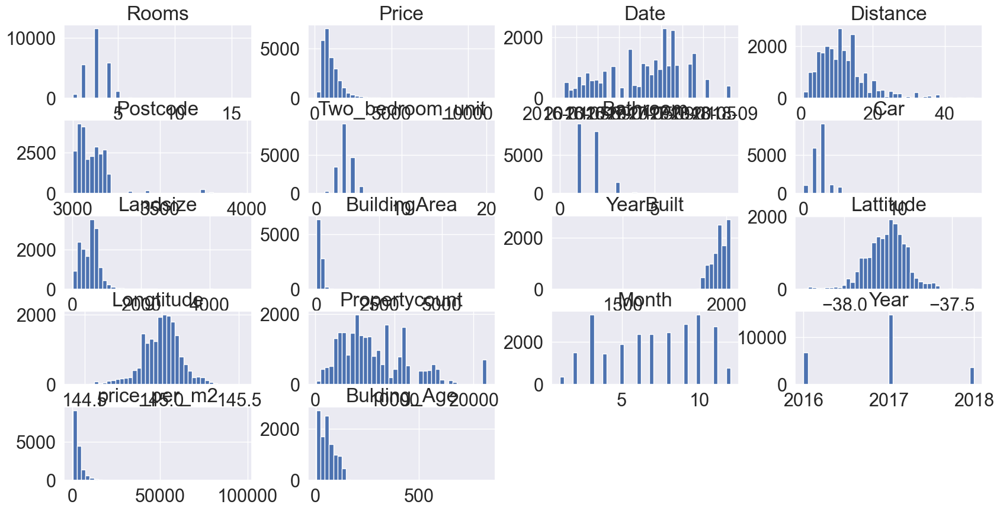

In [296]:
## numerical
df2.hist(bins=40, figsize=(20, 10))
plt.show()

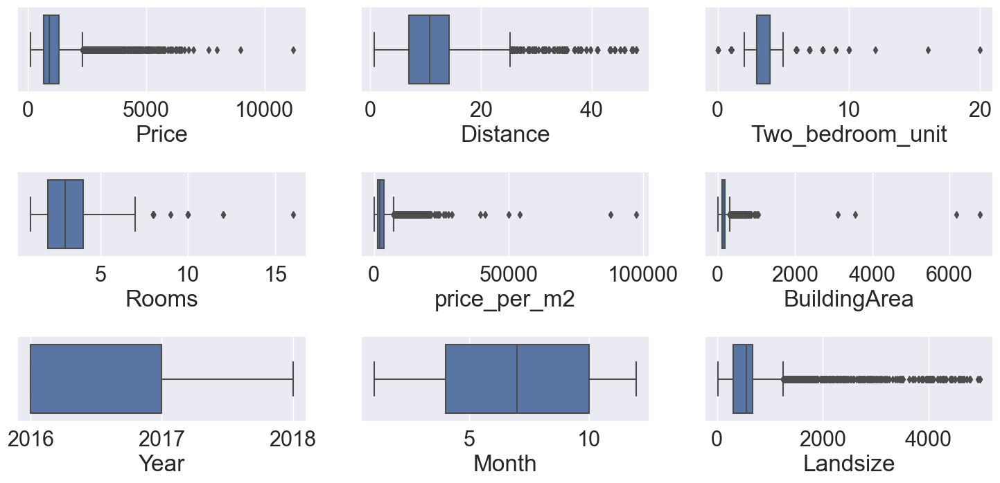

In [297]:
## Check All Numeric Types Features 

fig, axs = plt.subplots(3,3, figsize = (15,7.5))
plt1 = sns.boxplot(df2,x=df2['Price'], ax = axs[0,0])
plt2 = sns.boxplot(x=df2['Distance'], ax = axs[0,1])
plt3 = sns.boxplot(x=df2['Two_bedroom_unit'], ax = axs[0,2])
plt4 = sns.boxplot(x=df2['Rooms'], ax = axs[1,0])
plt5 = sns.boxplot(x=df2['price_per_m2'], ax = axs[1,1])
plt6 = sns.boxplot(x=df2['BuildingArea'], ax = axs[1,2])
plt7 = sns.boxplot(x=df2['Year'], ax = axs[2,0])
plt8 = sns.boxplot(x=df2['Month'], ax = axs[2,1])
plt9 = sns.boxplot(x=df2['Landsize'], ax = axs[2,2])
plt.tight_layout()

 ### `Imputing outliers`

In [298]:

percentiles = df2['Landsize'].quantile([0.05,0.95]).values
df2['Landsize'][df2['Landsize'] <= percentiles[0]] = percentiles[0]
df2['Landsize'][df2['Landsize'] >= percentiles[1]] = percentiles[1]

percentiles = df2['BuildingArea'].quantile([0.05,0.95]).values
df2['BuildingArea'][df2['BuildingArea'] <= percentiles[0]] = percentiles[0]
df2['BuildingArea'][df2['BuildingArea'] >= percentiles[1]] = percentiles[1]

percentiles = df2['Price'].quantile([0.05,0.95]).values
df2['Price'][df2['Price'] <= percentiles[0]] = percentiles[0]
df2['Price'][df2['Price'] >= percentiles[1]] = percentiles[1]

percentiles = df2['price_per_m2'].quantile([0.05,0.95]).values
df2['price_per_m2'][df2['price_per_m2'] <= percentiles[0]] = percentiles[0]
df2['price_per_m2'][df2['price_per_m2'] >= percentiles[1]] = percentiles[1]


percentiles = df2['Distance'].quantile([0.05,0.95]).values
df2['Distance'][df2['Distance'] <= percentiles[0]] = percentiles[0]
df2['Distance'][df2['Distance'] >= percentiles[1]] = percentiles[1]

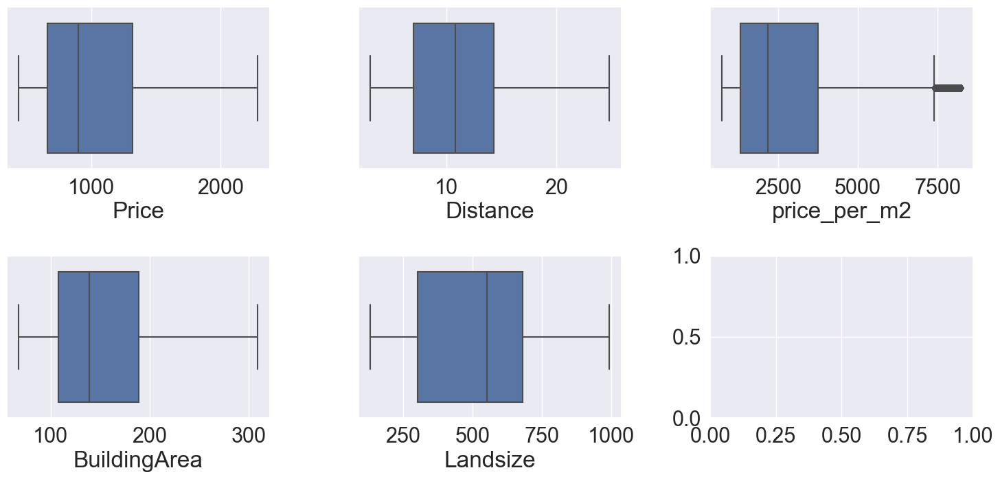

In [299]:
fig, axs = plt.subplots(2,3, figsize = (15,7.5))
plt1 = sns.boxplot(df2,x=df2['Price'], ax = axs[0,0])
plt2 = sns.boxplot(x=df2['Distance'], ax = axs[0,1])
plt5 = sns.boxplot(x=df2['price_per_m2'], ax = axs[0,2])
plt6 = sns.boxplot(x=df2['BuildingArea'], ax = axs[1,0])
plt9 = sns.boxplot(x=df2['Landsize'], ax = axs[1,1])
plt.tight_layout()

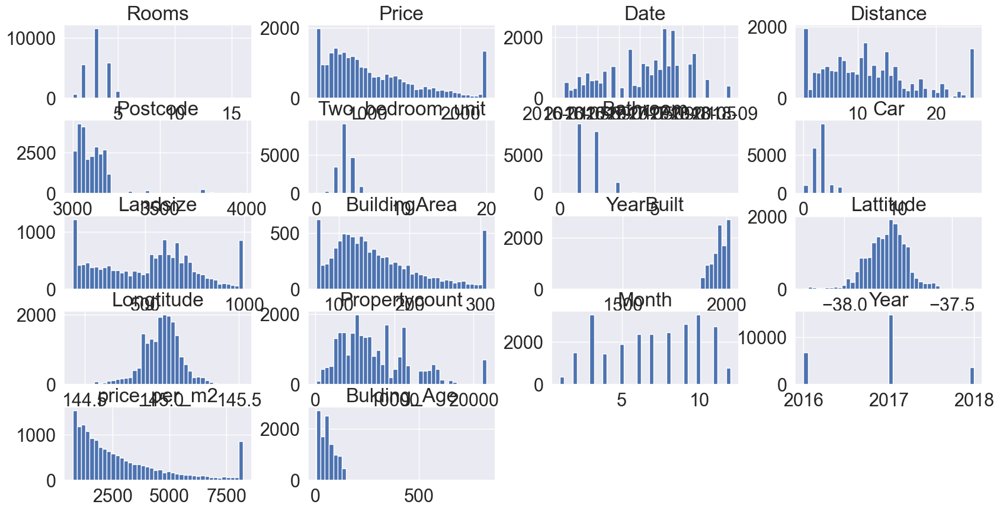

In [300]:
df2.hist(bins=40, figsize=(20, 10))
plt.show()

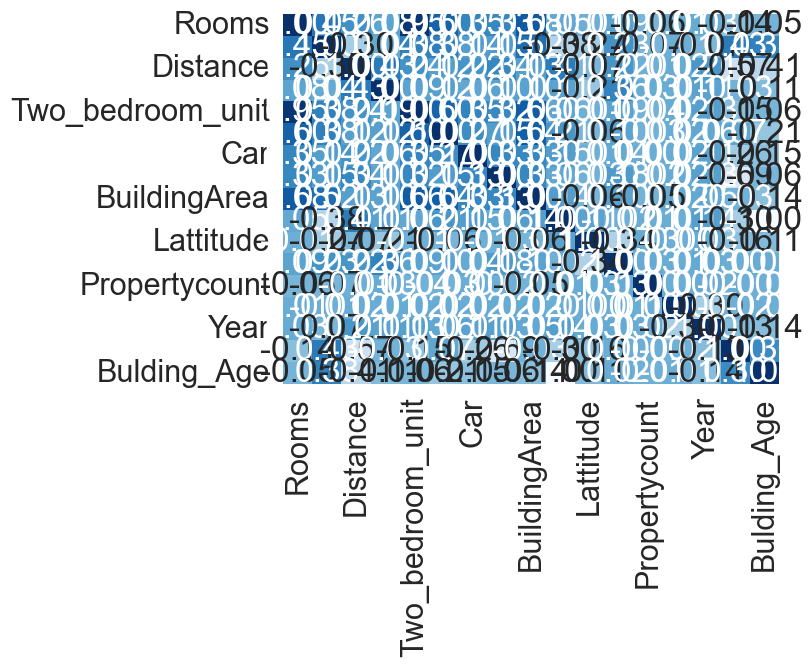

In [301]:
## Correlation
df_corr = df2.corr()
sns.heatmap(df_corr, annot=True, cbar=False, fmt='.2f', cmap='Blues')
plt.show()

In [302]:

# Select the highest correlation to the price
highest_corr_pairs = df_corr.nlargest(1, 'Price', keep='first',)

# Print the highest correlation pairs
highest_corr_pairs

,Rooms,Price,Distance,Postcode,Two_bedroom_unit,Bathroom,Car,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,Propertycount,Month,Year,price_per_m2,Bulding_Age
Price,0.448425,1.0,-0.299537,0.037824,0.379255,0.384391,0.143767,0.152933,0.520853,-0.376701,-0.27362,0.234596,-0.066356,-0.006118,-0.071263,0.427073,0.376701


#  <span style='color:green '> Step04-- Bussinesss Understanding and data relations using data visulaization</span>

In [303]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 25164 entries, 1 to 34856
Data columns (total 28 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   Suburb            25164 non-null  object        
 1   Address           25164 non-null  object        
 2   Rooms             25164 non-null  int64         
 3   Type              25164 non-null  object        
 4   Price             25164 non-null  float64       
 5   Method            25164 non-null  object        
 6   Seller            25164 non-null  object        
 7   Date              25164 non-null  datetime64[ns]
 8   Distance          25163 non-null  float64       
 9   Postcode          25163 non-null  float64       
 10  Two_bedroom_unit  18773 non-null  float64       
 11  Bathroom          18767 non-null  float64       
 12  Car               18397 non-null  float64       
 13  Landsize          15951 non-null  float64       
 14  BuildingArea      9547

* `Univariate Viz`

<Axes: >

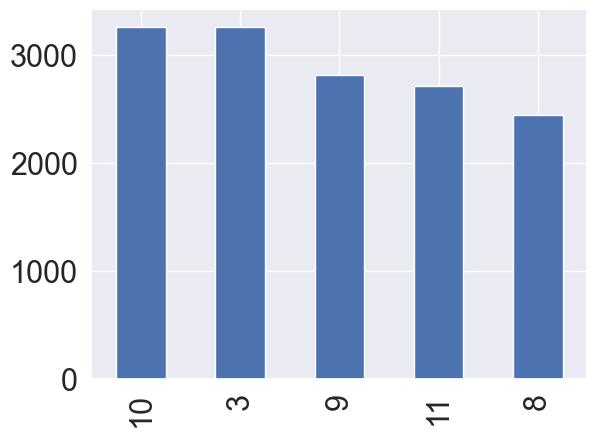

In [304]:
## What is the most month that the units got sell


df2['Month'].value_counts().head().plot(kind= 'bar')

# As due to the study time and the good entertainment time month (3,10) are the most month


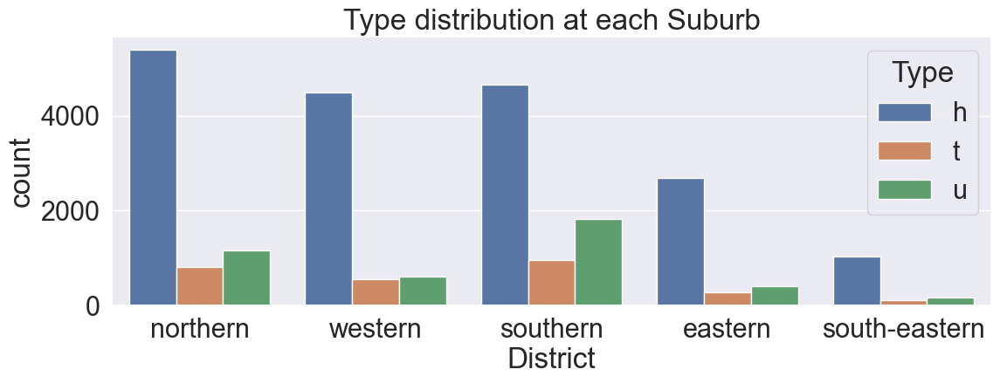

In [305]:
# What are the most  type sold at each subrub
fig = plt.figure(figsize = (13,4))
sns.countplot(x=df2['District'], hue=df2['Type'])
df2.head()
plt.title('Type distribution at each Suburb')
plt.show()

# Then Type h is the most sold one at each district where all northern are prefere it 

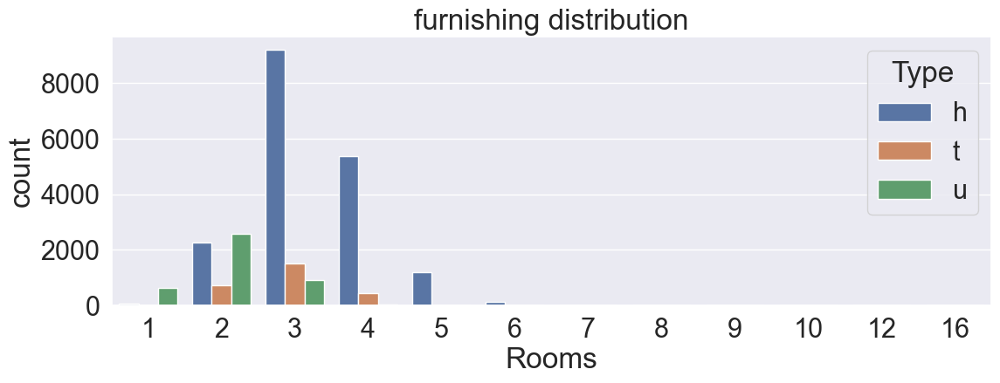

In [306]:
# What are the most no of rooms sold accoring to each prop_type
fig = plt.figure(figsize = (13,4))
sns.countplot(data=df2, x=df2['Rooms'], hue=df2['Type'])
df2.head()
plt.title('furnishing distribution')
plt.show()

# then house type with 3 rooms is the most popular one


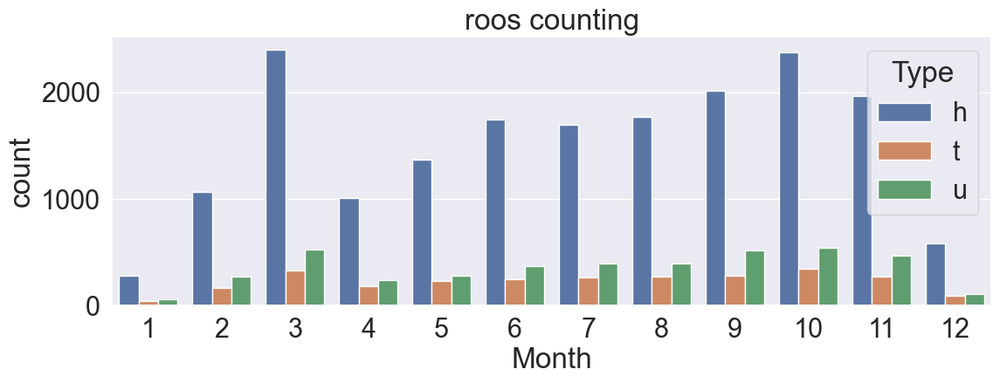

In [307]:
# wat are the most the most type at each month 
fig = plt.figure(figsize = (13,4))
sns.countplot(x=df2['Month'], hue=df2['Type'])
df2.head()
plt.title('roos counting')
plt.show()

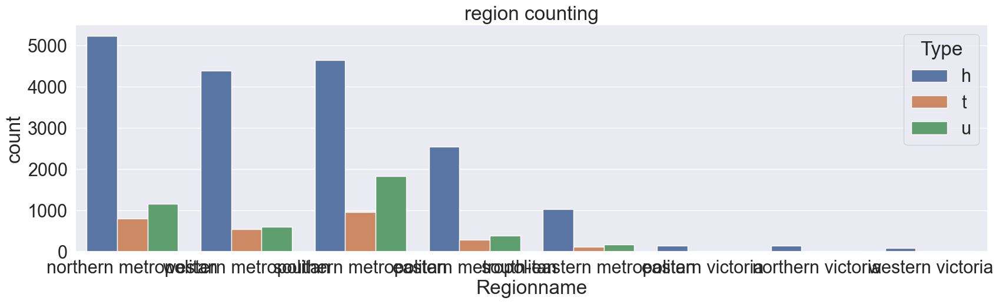

In [308]:
## at any region the most Type at each region
fig = plt.figure(figsize = (20,5))
sns.countplot(x=df2['Regionname'], hue=df2['Type'])
df2.head()
plt.title('region counting')
plt.show()

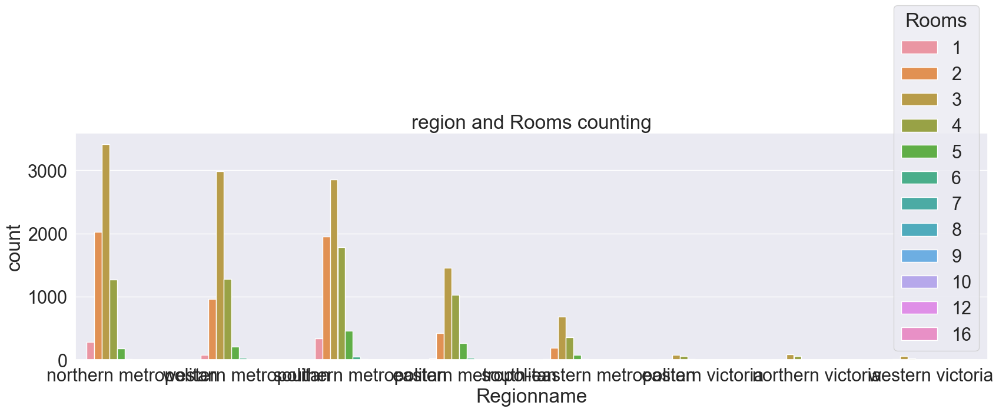

In [309]:
## at any region the most Rooms No sold at each region
fig = plt.figure(figsize = (20,5))
sns.countplot(x=df2['Regionname'], hue=df2['Rooms'])
df2.head()
plt.title('region and Rooms counting')
plt.show()

In [310]:
## at any region the most price per meter distribution exist in each region
fig = px.box(df2, y=df2['price_per_m2'], x=df2['Regionname'],)
fig.show()

In [311]:
# What is the mean of price per m2 at each region
z1=[]
z2=[]
for x in df2['Regionname'].unique():
 price_per_m2= (df2['price_per_m2'][df2['Regionname']== x]).mean()
 z1.append(price_per_m2)
 z2.append(x)
print(' mean of price_per_m2 in  at each region is')
pd.DataFrame(z1,z2)


 mean of price_per_m2 in  at each region is


,0
northern metropolitan,3017.578522
western metropolitan,2348.716469
southern metropolitan,3844.662125
eastern metropolitan,2009.279257
south-eastern metropolitan,1669.043336
eastern victoria,970.983480
northern victoria,1007.977031
western victoria,770.244631
NaN,NaN


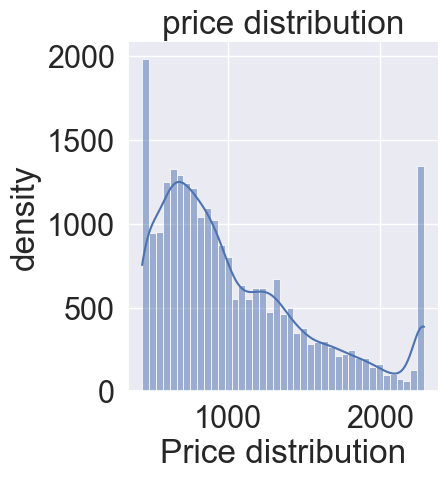

In [312]:
sns.displot(df2['Price'], kde= True)
plt.title('price distribution')
plt.ylabel('density')
plt.xlabel('Price distribution')
plt.show()

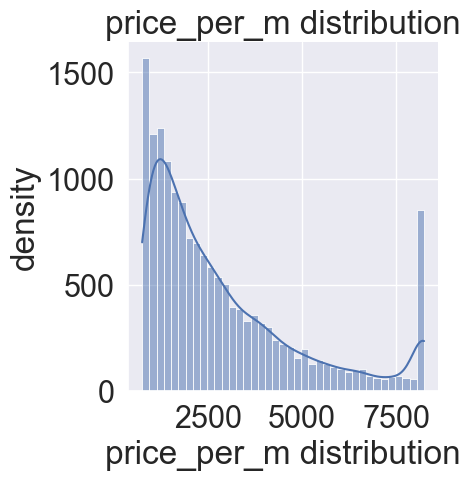

In [313]:
sns.displot(df2['price_per_m2'], kde= True)
plt.title('price_per_m distribution')
plt.ylabel('density')
plt.xlabel('price_per_m distribution')
plt.show()

In [314]:
## at any region the most median of price distribution exist in each region
fig = px.box(df2, y=df2['Price'], x=df2['Regionname'],)
fig.show()

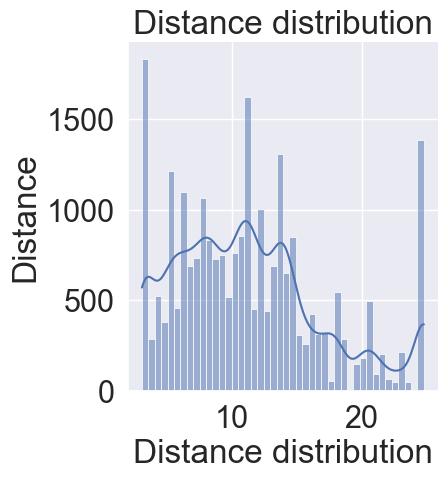

In [315]:
sns.displot(df2['Distance'], kde= True)
plt.title('Distance distribution')
plt.ylabel('Distance')
plt.xlabel('Distance distribution')
plt.show()

In [316]:
# What are the most seller for each type in melbourn
df2['Seller'].value_counts()

# Nelson is the most one

nelson              2525
barry               2359
jellis              2289
hockingstuart       1837
ray                 1525
                    ... 
steveway               1
better                 1
buxton/advantage       1
allan                  1
sanctuary              1
Name: Seller, Length: 335, dtype: int64

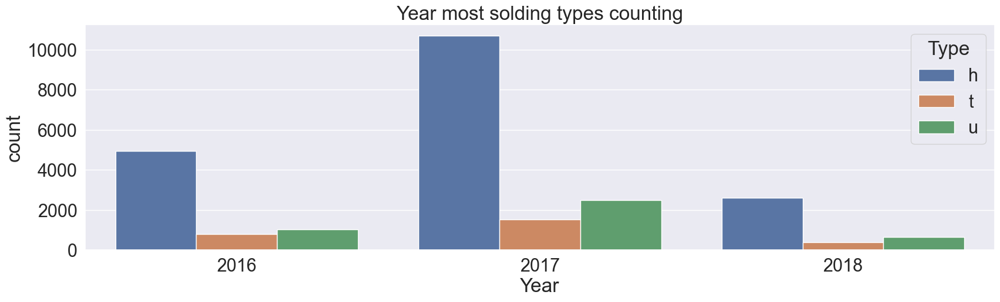

In [317]:
# At which year was the most sold types
fig = plt.figure(figsize = (20,5))
sns.countplot(x=df2['Year'], hue=df2['Type'])
df2.head()
plt.title('Year most solding types counting')
plt.show()

Which suburbs are the best to buy in?
- Which ones are value for money?
- Where's the expensive side of town?
- where should I buy a 2 bedroom unit?

* `Bivariate Viz`

In [318]:
# What are the feature that affecting directly correlation to your price
# Select the highest correlation to the price
highest_corr_pairs = df_corr.nlargest(1, 'Price', keep='first',)

# Print the highest correlation pairs
highest_corr_pairs.T


,Price
Rooms,0.448425
Price,1.000000
Distance,-0.299537
Postcode,0.037824
Two_bedroom_unit,0.379255
Bathroom,0.384391
Car,0.143767
Landsize,0.152933
BuildingArea,0.520853
YearBuilt,-0.376701


In [319]:
# scatter plot of the most effective correlated features to the price 
px.scatter_matrix(df2,dimensions=['Price', 'price_per_m2', 'BuildingArea','Rooms','Two_bedroom_unit','Bathroom','BuildingArea','YearBuilt'], title='PairPlot for price with  some most correlated Features')

In [320]:
# what is the relation between price and price per m2

px.scatter_matrix(df2, dimensions=['Price', 'price_per_m2'])

# so the price has reverse correlation with its related to m2 that mean when m2 incraese the price increase 

In [321]:
# what is the relation between price and building area
px.scatter_matrix(df2, dimensions=['Price', 'BuildingArea'])

In [322]:
# what is the relation between price and Rooms
px.scatter_matrix(df2, dimensions=['Price', 'Rooms','Bathroom'])

# So when the no of rooms and bathrooms increased the price increase

In [323]:
# what is the relation between price and Rooms
px.scatter_matrix(df2, dimensions=['Price', 'Two_bedroom_unit','YearBuilt'])

# so when there us two bed room unit the cost incrased slightly alos with old year bult get low price

In [324]:
## why two bed room is the best choise
px.violin(df2, x="Two_bedroom_unit", y="Price", 
          title='ViolinPlot at different two bedrooms with price ', box=True)

# So it is a vailable with good price 

In [325]:
# whitch city is the best price median
Price_median = df2.groupby('CouncilArea')['Price'].median().reset_index(name='Price_median')
Price_median

,CouncilArea,Price_median
0,banyule,835.00
1,bayside,1460.00
2,boroondara,1670.00
3,brimbank,667.50
4,cardinia,525.50
5,casey,645.00
6,darebin,850.00
7,frankston,647.00
8,glen,1190.00
9,greater,687.00


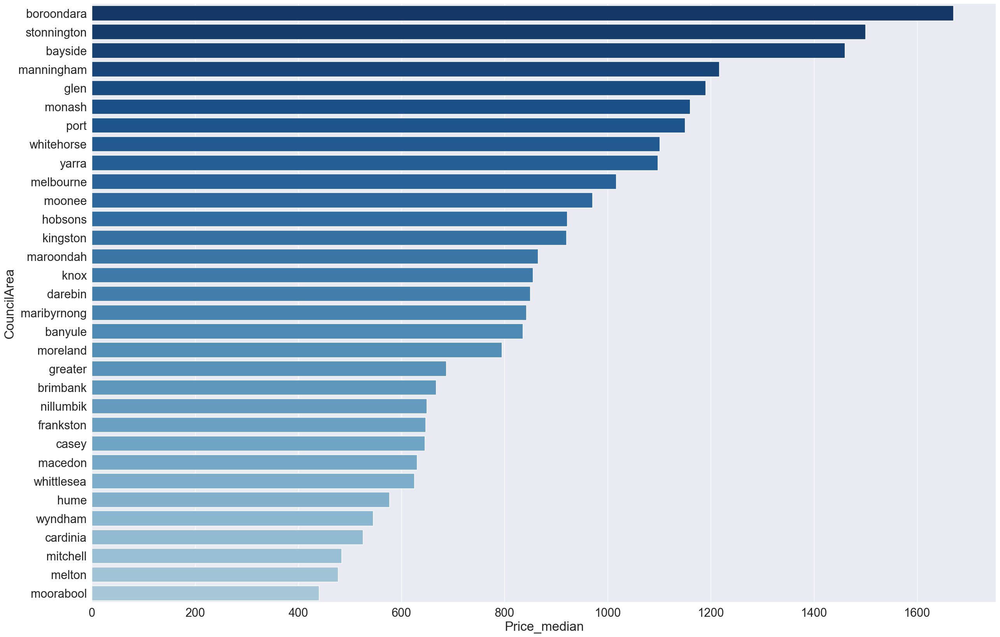

In [326]:
Price_median = Price_median.sort_values(by ='Price_median',ascending = False)
#Median price bar charts for each city
f, ax = plt.subplots(figsize=(30, 20))
ax.get_xaxis().get_major_formatter().set_scientific(False)
sns.set(font_scale = 2)
sns.barplot(data=Price_median, x = 'Price_median',y = 'CouncilArea',palette=sns.color_palette('Blues_r',50))
plt.show()

In [327]:
# whitch city is the best price median for each type and two bed_room
Price_median = df2.groupby(['CouncilArea','Type','Two_bedroom_unit'])['Price'].median().reset_index(name='Price_median')
Price_median

,CouncilArea,Type,Two_bedroom_unit,Price_median
0,banyule,h,0.0,2285.85
1,banyule,h,1.0,442.00
2,banyule,h,2.0,728.00
3,banyule,h,3.0,845.00
4,banyule,h,4.0,1023.00
...,...,...,...,...
370,yarra,t,3.0,1193.00
371,yarra,t,4.0,1525.00
372,yarra,u,1.0,440.00
373,yarra,u,2.0,640.00


In [328]:
# whitch sururb is the best price median
Price_median = df2.groupby(['Suburb'])['Price'].median().reset_index(name='Price_median')
Price_median=Price_median.sort_values(by='Price_median', ascending=True)

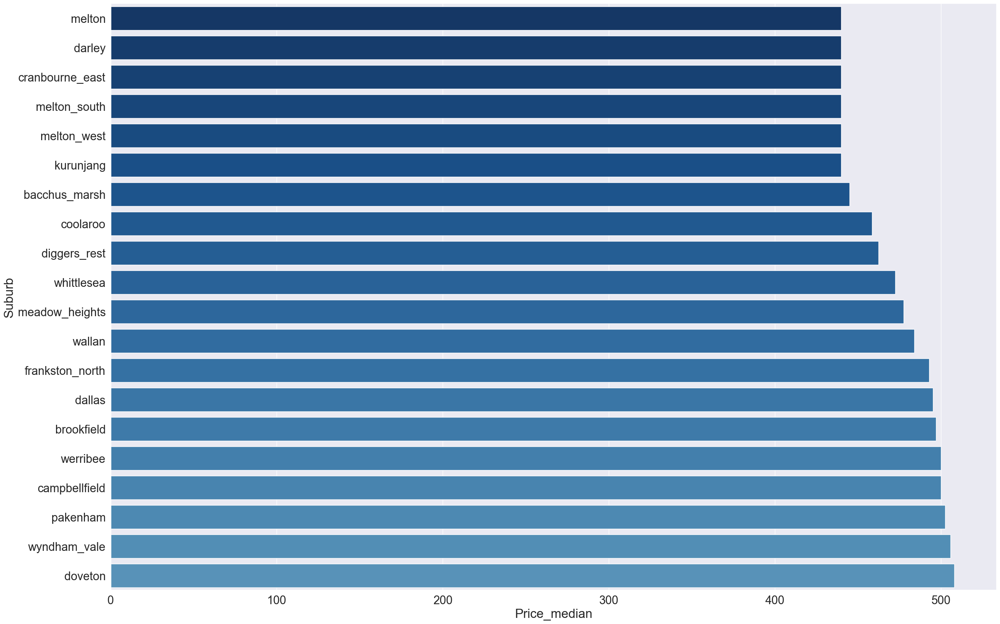

In [329]:
df_new=Price_median.head(20)
Price_median = df_new.sort_values(by ='Price_median',ascending = True)
#Median price bar charts for each city
f, ax = plt.subplots(figsize=(30, 20))
ax.get_xaxis().get_major_formatter().set_scientific(False)
sns.set(font_scale = 2)
sns.barplot(data=Price_median, x = 'Price_median',y = 'Suburb',palette=sns.color_palette('Blues_r',50))
plt.show()

In [330]:
df2.columns

Index(['Suburb', 'Address', 'Rooms', 'Type', 'Price', 'Method', 'Seller',
       'Date', 'Distance', 'Postcode', 'Two_bedroom_unit', 'Bathroom', 'Car',
       'Landsize', 'BuildingArea', 'YearBuilt', 'CouncilArea', 'Lattitude',
       'Longtitude', 'Regionname', 'Propertycount', 'Bedroom2', 'Region',
       'District', 'Month', 'Year', 'price_per_m2', 'Bulding_Age'],
      dtype='object')

In [331]:
# what is the price distribution at each area 
fig = px.scatter(x='BuildingArea', y='Price', data_frame=df2, marginal_x='violin', 
                title='ScatterPlot for size in sq.meter and Price', 
                marginal_y='box', color='Rooms')

fig.update_xaxes(title_text='Area')
fig.update_yaxes(title_text='Price')
fig.show()

In [332]:
## show the box
px.violin(df2, x="Type", y="Price", color="Region", 
          title='ViolinPlot at different rooms with monthly rent', box=True)

In [333]:
px.histogram(df2, x='Price', color='Rooms', facet_col='Region', facet_col_wrap=2, nbins=30, 
             title='Histogram at different rooms according to monthly rent')

In [334]:
df2.columns

Index(['Suburb', 'Address', 'Rooms', 'Type', 'Price', 'Method', 'Seller',
       'Date', 'Distance', 'Postcode', 'Two_bedroom_unit', 'Bathroom', 'Car',
       'Landsize', 'BuildingArea', 'YearBuilt', 'CouncilArea', 'Lattitude',
       'Longtitude', 'Regionname', 'Propertycount', 'Bedroom2', 'Region',
       'District', 'Month', 'Year', 'price_per_m2', 'Bulding_Age'],
      dtype='object')

In [335]:
# Does two bed rooms have an effect on the rent and have arelation with area
fig = px.scatter(x='BuildingArea', y='Price', data_frame=df2, marginal_x='violin', 
                title='ScatterPlot for size in sq.meter and Price', 
                marginal_y='box', color='Two_bedroom_unit')

fig.update_xaxes(title_text='size in sq.meter')
fig.update_yaxes(title_text='Price')
fig.show()

In [336]:

fig1 = px.strip(df2, x='Bathroom', y='Price', color_discrete_sequence=['red'], 
              title='StripPlot & ViolinPlot of monthly rent  at different facilities')
fig2 = px.violin(df2, x='Bathroom', y='Price')

all_fig = go.Figure(data=fig1.data + fig2.data, layout=fig1.layout)  ## combine
all_fig.show()

In [337]:
px.box(df2, x="Year", y="Price", points='all', title="Tips Distribution with boxPlot and StripPlot")

In [338]:
# What is the max price at each month for each year
fig = px.scatter(x='Month', y='Price', data_frame=df2, marginal_x='violin', 
                title='ScatterPlot for size in sq.meter and monthly rent', 
                marginal_y='box', color='Year')

fig.update_xaxes(title_text='Price for each month at each year')
fig.show()

In [339]:
# What is the max area sold at each month for each year
fig = px.scatter(x='Month', y='BuildingArea', data_frame=df2, marginal_x='violin', 
                title='ScatterPlot for size in sq.meter and monthly rent', 
                marginal_y='box', color='Year')

fig.update_xaxes(title_text='Area of properties for each month at each year')
fig.show()

In [340]:
# what is the type for each month with each method
fig = px.sunburst(df2, path=['Type','Rooms', 'Year', 'Method'], values='Price')
fig.show()

In [341]:


# what is the mean of bulding age at each regionname
fig = px.box(df2, y=df2['Bulding_Age'], x=df2['Regionname'],)
fig.show()

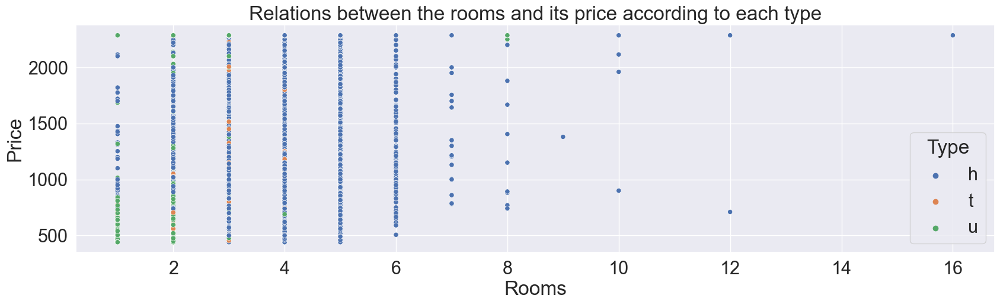

In [342]:
# Relations between the rooms and its price according to each type
fig = plt.figure(figsize = (20,5))
sns.scatterplot(data=df2, x='Rooms', y='Price', hue='Type')
plt.title('Relations between the rooms and its price according to each type')
plt.show()

## Feature Seelection

### Using Correlation method

In [416]:
# What are the feature that affecting directly correlation to your price
# Select the highest correlation to the price
highest_corr_pairs = df_corr.nlargest(1, 'Price', keep='first',)

# Print the highest correlation pairs
highest_corr_pairs.T


,Price
Rooms,0.448425
Price,1.000000
Distance,-0.299537
Postcode,0.037824
Two_bedroom_unit,0.379255
Bathroom,0.384391
Car,0.143767
Landsize,0.152933
BuildingArea,0.520853
YearBuilt,-0.376701


In [344]:
df2.drop(df2[['Address','Date','Bedroom2','price_per_m2','Bulding_Age','Postcode','Year','Postcode']], axis=1, inplace=True)

In [345]:

df2.columns

Index(['Suburb', 'Rooms', 'Type', 'Price', 'Method', 'Seller', 'Distance',
       'Two_bedroom_unit', 'Bathroom', 'Car', 'Landsize', 'BuildingArea',
       'YearBuilt', 'CouncilArea', 'Lattitude', 'Longtitude', 'Regionname',
       'Propertycount', 'Region', 'District', 'Month'],
      dtype='object')

In [346]:
(df2.isna().sum().sort_values(ascending= False)/ df2.shape[0])*100

BuildingArea        62.060881
YearBuilt           57.319981
Landsize            36.611826
Car                 26.891591
Bathroom            25.421237
Two_bedroom_unit    25.397393
Lattitude           24.650294
Longtitude          24.650294
District             0.011922
Region               0.011922
Propertycount        0.011922
Regionname           0.011922
CouncilArea          0.011922
Distance             0.003974
Suburb               0.000000
Rooms                0.000000
Seller               0.000000
Method               0.000000
Price                0.000000
Type                 0.000000
Month                0.000000
dtype: float64

In [347]:
## drop the unity unique values in property type
# idx03= df2[df2['property_type'].isin(['Condo','Residential','Bungalow','Houses','Soho'])].index.tolist()
# df2.drop(index=idx03, axis=0, inplace= True)


#  <span style='color:green '> Step05-- split data set </span>

In [348]:
## split to faetures and target
X = df2.drop(columns=['Price'], axis=1)   ## faetures
y = df2['Price']   ## traget

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, shuffle=True, random_state=110)

print('X_train.shape \t', X_train.shape)
print('y_train.shape \t', y_train.shape)
print('***'*20)
print('X_test.shape \t', X_test.shape)
print('y_test.shape \t', y_test.shape)

X_train.shape 	 (18873, 20)
y_train.shape 	 (18873,)
************************************************************
X_test.shape 	 (6291, 20)
y_test.shape 	 (6291,)


#  <span style='color:green '> Step06-- Data Preprocessing </span>

### `Feature Transformations`

In [349]:
## Get the Numerical and Catgeorcial columns
num_cols = X_train.select_dtypes(include='number').columns.tolist()
categ_cols = list(set(X_train.select_dtypes(exclude='number').columns.tolist())-set(['Type']))
other=['Type']


print('Numerical cols \t', num_cols)
print('Categorical cols \t', categ_cols)

Numerical cols 	 ['Rooms', 'Distance', 'Two_bedroom_unit', 'Bathroom', 'Car', 'Landsize', 'BuildingArea', 'YearBuilt', 'Lattitude', 'Longtitude', 'Propertycount', 'Month']
Categorical cols 	 ['CouncilArea', 'Method', 'Suburb', 'Region', 'District', 'Regionname', 'Seller']


In [350]:
## Building pipeline

## 1- Numerical pipeline

## for the completion years Nans
## about 46% of the values are nan
## completion years--- median
## parking--- median             
## rooms-- median                  
## bathroom -- median 
num_pipeline = Pipeline(steps=[
                        ('selector', DataFrameSelector(num_cols)),
                        ('imputer', SimpleImputer(strategy='mean')),
                        ('transform', PowerTransformer(method='yeo-johnson', standardize=True))
                ])


## Catgeorical pipeline
categ_pipeline = Pipeline(steps=[
                ('selector', DataFrameSelector(categ_cols)),
                ('imputer', SimpleImputer(strategy='most_frequent')),
                ('encoder', OrdinalEncoder(handle_unknown='use_encoded_value', unknown_value=-1))
               ])


## Combine all
all_pipe = FeatureUnion(transformer_list=[
                ('num', num_pipeline),
                ('categ', categ_pipeline)
            ])

## fit and transform
X_train_final = all_pipe.fit_transform(X_train)
X_test_final = all_pipe.transform(X_test)

In [351]:

num_pipeline = Pipeline(steps=[
                    
                        ('imputer', SimpleImputer(strategy='mean')),
                        ('transform', PowerTransformer(method='yeo-johnson', standardize=True))
                ])


## Catgeorical pipeline
categ_pipeline = Pipeline(steps=[
                
                ('imputer', SimpleImputer(strategy='most_frequent')),
                ('encoder', OrdinalEncoder(handle_unknown='use_encoded_value', unknown_value=-1))
               ])


other_pipeline = Pipeline(steps=[
                
                ('imputer', SimpleImputer(strategy='most_frequent')),
                ('encoder', OneHotEncoder())
               ])


## Combine all

preprocessing = ColumnTransformer(transformers=[('Numerical', num_pipeline, num_cols),
                                 ('Categorical', categ_pipeline, categ_cols),('other', other_pipeline, other)], remainder= 'passthrough')

## fit and transform
X_train_final = preprocessing.fit_transform(X_train)
X_test_final = preprocessing.transform(X_test)

### Feature Importance And selection using wrapped method Kbest

In [352]:
total_cols = num_cols + categ_cols+['Type_1', 'Type_2','Type_3']
total_cols

['Rooms',
 'Distance',
 'Two_bedroom_unit',
 'Bathroom',
 'Car',
 'Landsize',
 'BuildingArea',
 'YearBuilt',
 'Lattitude',
 'Longtitude',
 'Propertycount',
 'Month',
 'CouncilArea',
 'Method',
 'Suburb',
 'Region',
 'District',
 'Regionname',
 'Seller',
 'Type_1',
 'Type_2',
 'Type_3']

In [353]:
df_X_train_final = pd.DataFrame(X_train_final, columns=total_cols)
df_X_train_final.columns

Index(['Rooms', 'Distance', 'Two_bedroom_unit', 'Bathroom', 'Car', 'Landsize',
       'BuildingArea', 'YearBuilt', 'Lattitude', 'Longtitude', 'Propertycount',
       'Month', 'CouncilArea', 'Method', 'Suburb', 'Region', 'District',
       'Regionname', 'Seller', 'Type_1', 'Type_2', 'Type_3'],
      dtype='object')

In [354]:
from sklearn.feature_selection import SelectKBest, mutual_info_regression
fs = SelectKBest(mutual_info_regression, k= 'all')
fs.fit(df_X_train_final, y_train)
x_train_fs = fs.transform(df_X_train_final)
x_test_fs = fs.transform(X_test_final)

<Axes: >

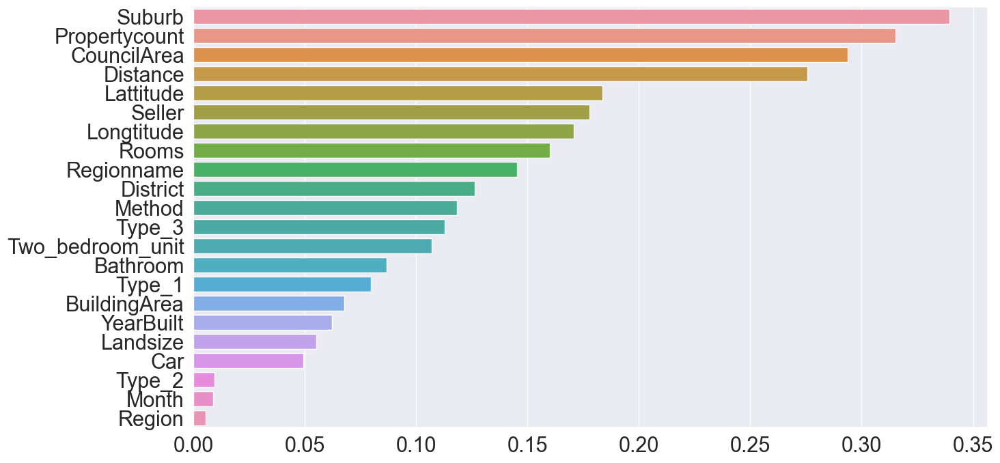

In [355]:
import seaborn as sns
import matplotlib.pyplot as plt
# Get the indices sorted by most important to least important
plt.figure(figsize=[15, 8])
indices = np.argsort(fs.scores_)[::-1]

# To get your top 10 feature names
features = []
for i in range(22):
    features.append(fs.feature_names_in_[indices[i]])

# Now plot
sns.barplot(x = fs.scores_[indices[range(22)]], y = features)

### `Building Models`

#### `1. Linear Regression`

In [356]:
## intialize 
lin_reg = LinearRegression(n_jobs=-1)
lin_reg.fit(X_train_final, y_train)   ## train


## Predict and Evaluate Model
y_pred_train_lin = lin_reg.predict(X_train_final)    ## you have the true value for train data (y_train)
y_pred_test_lin = lin_reg.predict(X_test_final)       ## you have the true value for train data (y_test)


## Evaluate Model USING RMSE
rmse_train_lin = np.sqrt(mean_squared_error(y_train, y_pred_train_lin))
rmse_test_lin = np.sqrt(mean_squared_error(y_test, y_pred_test_lin))

print(f'RMSE of Training Dataset using LinearRegression Model is: {rmse_train_lin:.3f}')
print(f'RMSE of Testing Dataset using LinearRegression Model is: {rmse_test_lin:.3f}')      ## No Overfitting

RMSE of Training Dataset using LinearRegression Model is: 321.474
RMSE of Testing Dataset using LinearRegression Model is: 322.346


### `2. Polynomail Features`

In [357]:
## Use degree=3
poly = PolynomialFeatures(degree=2, include_bias=False)
## fitting and transforming
X_train_final2 = poly.fit_transform(X_train_final)
X_test_final2 = poly.transform(X_test_final)


## Ready for Model ---> Uing LinearRegression
## intialize 
poly_reg = LinearRegression(n_jobs=-1)
poly_reg.fit(X_train_final2, y_train)   ## train

## Predict and Evaluate Model
y_pred_train_poly = poly_reg.predict(X_train_final2)    ## you have the true value for train data (y_train)
y_pred_test_poly = poly_reg.predict(X_test_final2)       ## you have the true value for train data (y_test)


## Evaluate Model USING RMSE
rmse_train_poly = np.sqrt(mean_squared_error(y_train, y_pred_train_poly))
rmse_test_poly = np.sqrt(mean_squared_error(y_test, y_pred_test_poly))

print(f'RMSE of Training Dataset using LinearRegression with PolynomailFetaures is: {rmse_train_poly:.3f}')
print(f'RMSE of Testing Dataset using LinearRegression with PolynomailFetaures is: {rmse_test_poly:.3f}')     ## No Overfitting.


RMSE of Training Dataset using LinearRegression with PolynomailFetaures is: 245.084
RMSE of Testing Dataset using LinearRegression with PolynomailFetaures is: 249.697


### `RandomForestRegressor`

In [358]:

## fitting and transforming
forst_clf = RandomForestRegressor(n_estimators=600, max_depth=50, random_state=45, min_samples_leaf=4,min_samples_split=2,max_features=0.8)
forst_clf.fit(X_train_final, y_train)

## Predict and evaluate 
y_pred_train_forest = forst_clf.predict(X_train_final)
y_pred_test_forest = forst_clf.predict(X_test_final)      ## you have the true value for train data (y_test)


## Evaluate Model USING RMSE
rmse_train_RF = np.sqrt(mean_squared_error(y_train, y_pred_train_forest))
rmse_test_RF= np.sqrt(mean_squared_error(y_test, y_pred_test_forest))

print(f'RMSE of Training Dataset using RandomForestRegressor is: {rmse_train_RF:.3f}')
print(f'RMSE of Testing Dataset using RandomForestRegressor is: {rmse_test_RF:.3f}')     ## No Overfitting.


RMSE of Training Dataset using RandomForestRegressor is: 140.946
RMSE of Testing Dataset using RandomForestRegressor is: 208.554


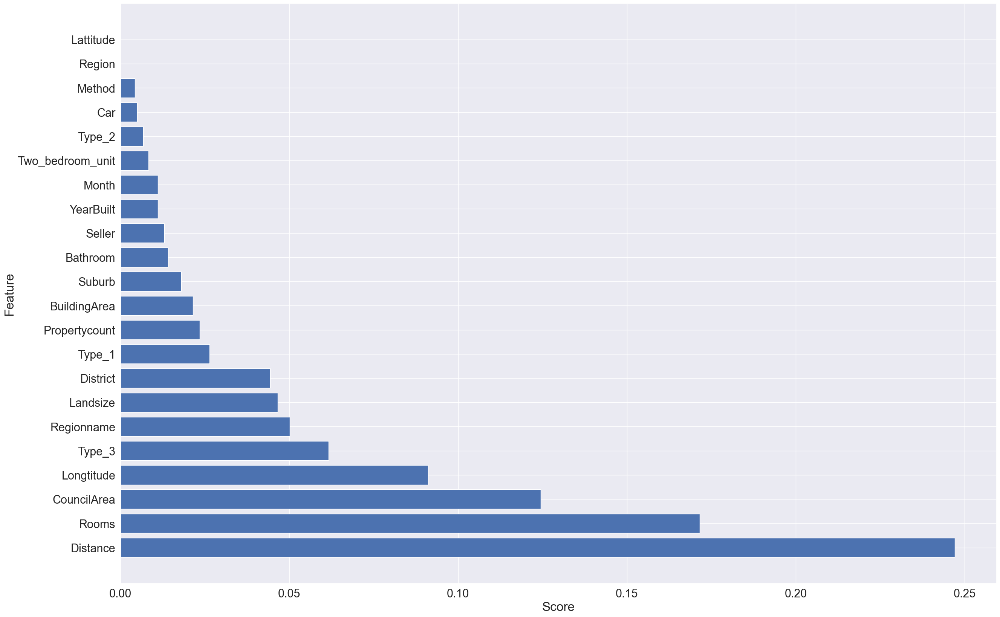

In [359]:
## Feature Importance using RF
feat_dict = {}
for name, score in zip(df_X_train_final.columns, forst_clf.feature_importances_):
    feat_dict[name] = score

keys_dict = feat_dict.keys()
values_dict = feat_dict.values()

df_feature_importance = pd.DataFrame({'Features': keys_dict, 'Scores': values_dict})
df_feature_importance.sort_values(by='Scores', ascending=False, inplace=True)

## plotting
plt.figure(figsize=(30, 20))
plt.barh(y=df_feature_importance['Features'], width=df_feature_importance['Scores'])
plt.xlabel('Score')
plt.ylabel('Feature')

plt.show()

### `SGD`

In [379]:
## Using SGD with Early Stopping
sgd_reg = SGDRegressor(penalty='l1', learning_rate='constant', eta0=0.000001, early_stopping=True,tol=0.000001,
                       
                       n_iter_no_change=200, validation_fraction=0.001, max_iter=100000,alpha=0.00001,l1_ratio=1,random_state=42,)
sgd_reg.fit(X_train_final, y_train)   ## training

## Predict and Evaluate Model
y_pred_train_sgd = sgd_reg.predict(X_train_final)    ## you have the true value for train data (y_train)
y_pred_test_sgd = sgd_reg.predict(X_test_final)       ## you have the true value for train data (y_test)


## Evaluate Model USING RMSE
rmse_train_sgd = np.sqrt(mean_squared_error(y_train, y_pred_train_sgd))
rmse_test_sgd = np.sqrt(mean_squared_error(y_test, y_pred_test_sgd))

print(f'RMSE of Training Dataset using SGDRegression is: {rmse_train_sgd:.3f}')
print(f'RMSE of Testing Dataset using SGDRegression is: {rmse_test_sgd:.3f}')     

RMSE of Training Dataset using SGDRegression is: 324.900
RMSE of Testing Dataset using SGDRegression is: 325.204


### `DecisionTreeRegressor`

In [361]:

## fitting and transforming
Tr_reg = DecisionTreeRegressor(min_samples_leaf=2,min_samples_split=2,criterion='poisson', max_depth=10)
Tr_reg.fit(X_train_final, y_train)

## Predict and evaluate 
y_pred_train_tree = Tr_reg.predict(X_train_final)
y_pred_test_tree = Tr_reg.predict(X_test_final)      ## you have the true value for train data (y_test)


## Evaluate Model USING RMSE
rmse_train_DT = np.sqrt(mean_squared_error(y_train, y_pred_train_tree))
rmse_test_DT = np.sqrt(mean_squared_error(y_test, y_pred_test_tree))

print(f'RMSE of Training Dataset using DecisionTreeRegressor is: {rmse_train_DT:.3f}')
print(f'RMSE of Testing Dataset using DecisionTreeRegressor is: {rmse_test_DT:.3f}')     ## No Overfitting.


RMSE of Training Dataset using DecisionTreeRegressor is: 214.487
RMSE of Testing Dataset using DecisionTreeRegressor is: 260.216


### `XGBRegressor`

In [362]:

## fitting and transforming
XGB_reg = XGBRegressor(learning_rate=0.03,n_estimators=600, max_depth=7, random_state=40,subsample=0.8,colsample_bytree=0.8,gamma=0.001,min_child_weight=2, scale_pos_weight=3,reg_lambda=0.01)
XGB_reg.fit(X_train_final, y_train)

## Predict and evaluate 
y_pred_train_XGB = XGB_reg.predict(X_train_final)
y_pred_test_XGB = XGB_reg.predict(X_test_final)      ## you have the true value for train data (y_test)


## Evaluate Model USING RMSE
rmse_train_XGB = np.sqrt(mean_squared_error(y_train, y_pred_train_XGB))
rmse_test_XGB = np.sqrt(mean_squared_error(y_test, y_pred_test_XGB))

print(f'RMSE of Training Dataset using XGBRegressor is: {rmse_train_XGB:.3f}')
print(f'RMSE of Testing Dataset using XGBRegressor is: {rmse_test_XGB:.3f}')     ## No Overfitting.


RMSE of Training Dataset using XGBRegressor is: 131.146
RMSE of Testing Dataset using XGBRegressor is: 195.295


### Ada boost

In [363]:

## fitting and transforming
DTR=DecisionTreeRegressor(min_samples_leaf=2,min_samples_split=2,criterion='poisson', max_depth=10)
RegModel = AdaBoostRegressor(n_estimators=50, estimator=DecisionTreeRegressor(min_samples_leaf=2,min_samples_split=2,criterion='poisson', max_depth=10)
                                               ,learning_rate=0.1)
AB= RegModel.fit(X_train_final, y_train)

## Predict and evaluate 
y_pred_train_RegModel = AB.predict(X_train_final)
y_pred_test_RegModel = AB.predict(X_test_final)      ## you have the true value for train data (y_test)


## Evaluate Model USING RMSE
rmse_train_AB = np.sqrt(mean_squared_error(y_train, y_pred_train_RegModel))
rmse_test_AB = np.sqrt(mean_squared_error(y_test, y_pred_test_RegModel))

print(f'RMSE of Training Dataset using AdaBoostRegressor is: {rmse_train_AB:.3f}')
print(f'RMSE of Testing Dataset using AdaBoostRegressor is: {rmse_test_AB:.3f}')     ## No Overfitting.


RMSE of Training Dataset using AdaBoostRegressor is: 181.949
RMSE of Testing Dataset using AdaBoostRegressor is: 222.069


Accuracy 84.45738117911371


<Axes: >

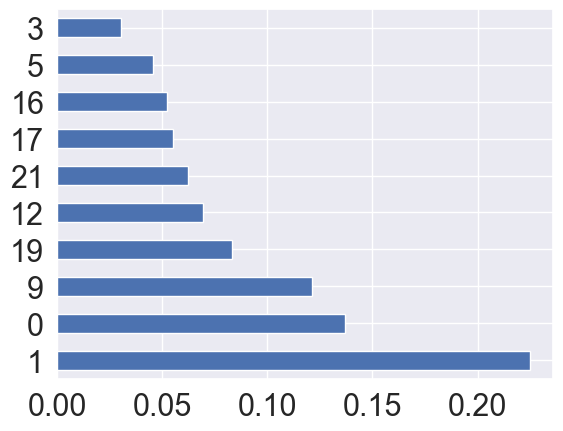

In [364]:
#Measuring accuracy on Testing Data
print('Accuracy',100- (np.mean(np.abs((y_test - y_pred_test_RegModel) / y_test)) * 100))
 
#Plotting the feature importance for Top 10 most important columns
%matplotlib inline
feature_importances = pd.Series(AB.feature_importances_)
feature_importances.nlargest(10).plot(kind='barh')

### lightGBM

[LightGBM] [Warning] Using too small ``bin_construct_sample_cnt`` may encounter unexpected errors and poor accuracy.
[LightGBM] [Info] Total Bins 1269
[LightGBM] [Info] Number of data points in the train set: 18873, number of used features: 22
[LightGBM] [Info] Start training from score 1044.893233
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

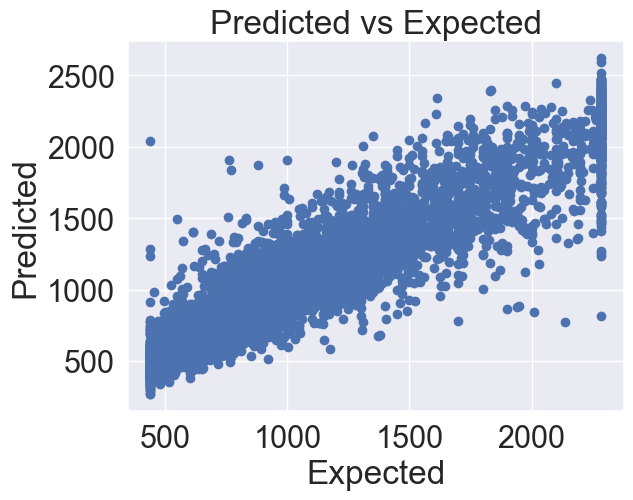

,0
Price,
1000.0,1292.057747
675.0,651.456986
440.0,515.668972
1610.0,2025.230673
1715.0,1310.408938
...,...
650.0,745.684789
1437.0,1675.708157
1390.0,1166.990269


In [412]:

## fitting and transforming
GBM_Model = lightgbm.LGBMRegressor(max_depth=5,n_estimators=500,random_state=42,learning_rate=0.1,force_row_wise=True,num_leaves=300,subsample=1.0,colsample_bytree=1.0,reg_lambda=0.5,subsample_for_bin=800)
GBM= GBM_Model.fit(X_train_final, y_train)

## Predict and evaluate 
y_pred_train_GBM = GBM.predict(X_train_final)
y_pred_test_GBM = GBM.predict(X_test_final)      ## you have the true value for train data (y_test)


## Evaluate Model USING RMSE
rmse_train_GBM = np.sqrt(mean_squared_error(y_train, y_pred_train_GBM))
rmse_test_GBM = np.sqrt(mean_squared_error(y_test, y_pred_test_GBM))

print(f'RMSE of Training Dataset using lightgbm is: {rmse_train_GBM:.3f}')
print(f'RMSE of Testing Dataset using lightgbm is: {rmse_test_GBM:.3f}')     ## No Overfitting.


import matplotlib.pyplot as plt

plt.scatter(y_test, y_pred_test_GBM)
plt.xlabel("Expected")
plt.ylabel("Predicted")
plt.title("Predicted vs Expected")
plt.show()

pd.DataFrame( y_pred_test_GBM, y_test)


In [366]:

#models = []
#models.append(("Linear Regression", LinearRegression(n_jobs=150)))
#models.append(("Knn", KNeighborsRegressor(n_neighbors=5,weights='uniform', p=1,metric='minkowski',)))

#models.append(('SGD',SGDRegressor(penalty='l2', learning_rate='constant', eta0=0.00000001, early_stopping=True,tol=0.000001,
                       
                       #n_iter_no_change=200, validation_fraction=0.001, max_iter=100000,alpha=0.00001,l1_ratio=1,random_state=42,)))
#models.append(("Decision Tree", DecisionTreeRegressor(min_samples_leaf=2,min_samples_split=2,criterion='poisson', max_depth=10)))
#models.append(("Random Forest", RandomForestRegressor(n_estimators=200, max_depth=10, random_state=45, min_samples_leaf=4,min_samples_split=2)))
#models.append(("Ada boost", AdaBoostRegressor(n_estimators=50, estimator=DecisionTreeRegressor(min_samples_leaf=2,min_samples_split=2,criterion='poisson', max_depth=10,learning_rate=0.1)))
#models.append(("Xgb", XGBRegressor(learning_rate=0.1,n_estimators=200, max_depth=5, random_state=45,subsample=0.9,colsample_bytree=0.9)))
#models.append(("lightGBM", lightgbm.LGBMRegressor(max_depth=5,n_estimators=300,random_state=42,learning_rate=0.1)))
#models.append(("SVC", SVR(kernel='poly', degree=2,C=1)))

#for model in models:
    #final_pipeline = Pipeline(steps=[('Preprocessing', preprocessing), ('Model', model[1])])
    #result = cross_validate(final_pipeline, X_train, y_train, cv = 5, return_train_score= True, scoring= 'r2')
    #print(model[0])
    #print('Train R2 score : ', (result['train_score'].mean()) * 100)
    #print('Test R2 score : ', (result['test_score'].mean()) * 100)
    #print('\n')

In [380]:
models = []
models.append(("Linear Regression", LinearRegression(n_jobs=-1)))
models.append(('SGD',SGDRegressor(penalty='l1', learning_rate='constant', eta0=0.000001, early_stopping=True,tol=0.000001,
                       n_iter_no_change=200, validation_fraction=0.001, max_iter=100000,alpha=0.00001,l1_ratio=1,random_state=42,)))

models.append(("Knn", KNeighborsRegressor(n_neighbors=5,weights='uniform', p=1,metric='minkowski',)))
models.append(("Decision Tree", DecisionTreeRegressor(min_samples_leaf=2,min_samples_split=2,criterion='poisson', max_depth=10)))

models.append(("Ada boost", AdaBoostRegressor(n_estimators=50, estimator=DecisionTreeRegressor(min_samples_leaf=2,min_samples_split=2,criterion='poisson', max_depth=10)
                                               ,learning_rate=0.1)))
models.append(("Xgb", XGBRegressor(learning_rate=0.03,n_estimators=600, max_depth=7, random_state=40,subsample=0.8,colsample_bytree=0.8,gamma=0.001,min_child_weight=2, scale_pos_weight=3,reg_lambda=0.01)))
models.append(("lightGBM",lightgbm.LGBMRegressor(max_depth=5,n_estimators=500,random_state=42,learning_rate=0.1,force_row_wise=True,num_leaves=300,subsample=1.0,colsample_bytree=1.0,reg_lambda=0.5,subsample_for_bin=800)))
models.append(("Random Forest", RandomForestRegressor(n_estimators=600, max_depth=50, random_state=45, min_samples_leaf=4,min_samples_split=2,max_features=0.8)))
for model in models:
    final_pipeline = Pipeline(steps=[('Preprocessing', preprocessing), ('Model', model[1])])
    result = cross_validate(final_pipeline, X_train, y_train, cv = 5, return_train_score= True, scoring= 'r2')
    print(model[0])
    print('Train R2 score : ', (result['train_score'].mean()) * 100)
    print('Test R2 score : ', (result['test_score'].mean()) * 100)
    print('\n')

Linear Regression
Train R2 score :  58.9999543395703
Test R2 score :  58.85180705300513


SGD
Train R2 score :  58.15767140838022
Test R2 score :  57.98283628071271


Knn
Train R2 score :  75.79341850757683
Test R2 score :  62.27350753609646


Decision Tree
Train R2 score :  82.11206218959525
Test R2 score :  74.1303841801524


Ada boost
Train R2 score :  87.51802712720205
Test R2 score :  80.62266066754121


Xgb
Train R2 score :  93.79204997860306
Test R2 score :  85.0010690961485


[LightGBM] [Warning] Using too small ``bin_construct_sample_cnt`` may encounter unexpected errors and poor accuracy.
[LightGBM] [Info] Total Bins 1178
[LightGBM] [Info] Number of data points in the train set: 15098, number of used features: 22
[LightGBM] [Info] Start training from score 1043.213646
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

In [368]:
## Use degree=2
poly = PolynomialFeatures(degree=2, include_bias=False)
## fitting and transforming
X_train_final2 = poly.fit_transform(X_train_final)
poly_reg = LinearRegression(n_jobs=-1)
poly_reg.fit(X_train_final2, y_train)   ## train

result = cross_validate(poly_reg, X_train_final2, y_train, cv = 5, return_train_score= True, scoring= 'r2')
print('POLYregression')
print('Train R2 score : ', (result['train_score'].mean()) * 100)
print('Test R2 score : ', (result['test_score'].mean()) * 100)

POLYregression
Train R2 score :  76.24022459665125
Test R2 score :  75.32520777261476


In [369]:
models = []

models.append(("Xgb", XGBRegressor(learning_rate=0.03,n_estimators=600, max_depth=7, random_state=40,subsample=0.8,colsample_bytree=0.8,gamma=0.001,min_child_weight=2, scale_pos_weight=3,reg_lambda=0.01)))
models.append(("lightGBM",lightgbm.LGBMRegressor(max_depth=5,n_estimators=500,random_state=42,learning_rate=0.1,force_row_wise=True,num_leaves=300,subsample=1.0,colsample_bytree=1.0,reg_lambda=0.5,subsample_for_bin=800)))
models.append(("Random Forest", RandomForestRegressor(n_estimators=600, max_depth=50, random_state=45, min_samples_leaf=4,min_samples_split=2,max_features=0.8)))
for model in models:
    final_pipeline = Pipeline(steps=[('Preprocessing', preprocessing), ('Model', model[1])])
    result = cross_validate(final_pipeline, X_train, y_train, cv = 5, return_train_score= True, scoring= 'r2')
    print(model[0])
    print('Train R2 score : ', (result['train_score'].mean()) * 100)
    print('Test R2 score : ', (result['test_score'].mean()) * 100)
    print('\n')

Xgb
Train R2 score :  93.79204997860306
Test R2 score :  85.0010690961485


[LightGBM] [Warning] Using too small ``bin_construct_sample_cnt`` may encounter unexpected errors and poor accuracy.
[LightGBM] [Info] Total Bins 1178
[LightGBM] [Info] Number of data points in the train set: 15098, number of used features: 22
[LightGBM] [Info] Start training from score 1043.213646
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

In [370]:
#from sklearn import svm
#models = []
#models.append(("Linear Regression", LinearRegression(n_jobs=150)))
#models.append(("Knn", KNeighborsRegressor(n_neighbors=5,weights='uniform', p=1,metric='minkowski',)))

#models.append(('SGD',SGDRegressor(penalty='l1', learning_rate='constant', eta0=0.00001, early_stopping=True,tol=0.00001,
                       #n_iter_no_change=200, validation_fraction=0.001, max_iter=100000,alpha=0.00001,l1_ratio=0.1,random_state=42)))
#models.append(("Decision Tree", DecisionTreeRegressor(min_samples_leaf=2,min_samples_split=2,criterion='poisson', max_depth=10)))
#models.append(("Random Forest", RandomForestRegressor(n_estimators=400, max_depth=50, random_state=45, min_samples_leaf=4,min_samples_split=2,max_features=0.8)))
#models.append(("Ada boost", AdaBoostRegressor(n_estimators=50, estimator=DecisionTreeRegressor(min_samples_leaf=2,min_samples_split=2,criterion='poisson', max_depth=10)
                                               #,learning_rate=0.1)))
#models.append(("Xgb", XGBRegressor(learning_rate=0.05,n_estimators=50, max_depth=20, random_state=45,subsample=0.9,colsample_bytree=0.9)))
#models.append(("lightGBM", lightgbm.LGBMRegressor(max_depth=15,n_estimators=50,random_state=42,learning_rate=0.2,force_row_wise=True,num_leaves=300)))
# models.append(("SVC", SVR(kernel='rbf', gamma=0.0001,C=10, tol=0.0001, epsilon=0.1, shrinking=True)))

for model in models:
    final_pipeline = Pipeline(steps=[('Preprocessing', preprocessing), ('Model', model[1])])
    result = cross_validate(final_pipeline, X_train, y_train, cv = 5, return_train_score= True, scoring= 'r2')
    print(model[0])
    print('Train R2 score : ', (result['train_score'].mean()) * 100)
    print('Test R2 score : ', (result['test_score'].mean()) * 100)
    print('\n')

Xgb
Train R2 score :  93.79204997860306
Test R2 score :  85.0010690961485


[LightGBM] [Warning] Using too small ``bin_construct_sample_cnt`` may encounter unexpected errors and poor accuracy.
[LightGBM] [Info] Total Bins 1178
[LightGBM] [Info] Number of data points in the train set: 15098, number of used features: 22
[LightGBM] [Info] Start training from score 1043.213646
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

## Models selection
#### After we make the cross balidation for some models we select 3 models:
##### 1- Random FOREST
##### 2- XG Boost
##### 3- Light GBM
 
And we wll tune XGBOOST And Randomforest as final two models

## Now lets tune and select best parameters for these models

In [371]:
z

NameError: name 'z' is not defined

In [372]:
### Random Forest
Model_RDF = RandomForestRegressor(random_state=45,n_jobs=-1)
params = {
    'n_estimators': np.arange(100, 601, 100),
    'max_depth': np.arange(4, 11),
    'min_samples_leaf': np.arange(2, 6),
   'min_samples_split': np.arange(2, 6),
   'max_features': [0.8,0.9, 1.0]
   

    }

grid_search = GridSearchCV(param_grid= params, estimator= Model_RDF, cv = 5, return_train_score= True, scoring= 'r2', n_jobs= -1)




In [ ]:
grid_search.fit(X_train_final, y_train)
# X_train_final = preprocessing.fit_transform(X_train)


In [ ]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 25164 entries, 1 to 34856
Data columns (total 16 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Suburb            25164 non-null  object 
 1   Rooms             25164 non-null  int64  
 2   Type              25164 non-null  object 
 3   Price             25164 non-null  float64
 4   Method            25164 non-null  object 
 5   Distance          25163 non-null  float64
 6   Two_bedroom_unit  18773 non-null  float64
 7   Bathroom          18767 non-null  float64
 8   Car               18397 non-null  float64
 9   CouncilArea       25161 non-null  object 
 10  Regionname        25161 non-null  object 
 11  Propertycount     25161 non-null  float64
 12  Region            25161 non-null  object 
 13  District          25161 non-null  object 
 14  Month             25164 non-null  int64  
 15  Year              25164 non-null  int64  
dtypes: float64(6), int64(3), object(7)
memor

In [ ]:
grid_search.best_params_

{'max_depth': 10,
 'min_samples_leaf': 4,
 'min_samples_split': 2,
 'n_estimators': 200}

In [ ]:
grid_search.best_score_

0.7814555422961402

In [ ]:
grid_search.cv_results_['mean_train_score']

array([0.31536463, 0.31542168, 0.31570496, 0.31557272, 0.31536463,
       0.31542168, 0.31570496, 0.31557272, 0.31536463, 0.31542168,
       0.31570496, 0.31557272, 0.31536463, 0.31542168, 0.31570496,
       0.31557272, 0.31536463, 0.31542168, 0.31570496, 0.31557272,
       0.31536463, 0.31542168, 0.31570496, 0.31557272, 0.31536463,
       0.31542168, 0.31570496, 0.31557272, 0.31536463, 0.31542168,
       0.31570496, 0.31557272, 0.31536463, 0.31542168, 0.31570496,
       0.31557272, 0.44117903, 0.44107124, 0.4416756 , 0.44132022,
       0.44117903, 0.44107124, 0.4416756 , 0.44132022, 0.44117903,
       0.44107124, 0.4416756 , 0.44132022, 0.44117903, 0.44107124,
       0.4416756 , 0.44132022, 0.44117903, 0.44107124, 0.4416756 ,
       0.44132022, 0.44117903, 0.44107124, 0.4416756 , 0.44132022,
       0.44117903, 0.44107124, 0.4416756 , 0.44132022, 0.44117903,
       0.44107124, 0.4416756 , 0.44132022, 0.44117903, 0.44107124,
       0.4416756 , 0.44132022, 0.53933189, 0.53896354, 0.53940

In [ ]:
grid_search.cv_results_['mean_train_score'].mean() * 100, grid_search.cv_results_['mean_test_score'].mean() * 100

(64.71644176830682, 63.068965390964685)

In [ ]:
grid_search.cv_results_

{'mean_fit_time': array([ 2.65352635,  1.8378582 ,  2.94517217,  4.24836402,  0.87965364,
         1.77589836,  2.63436503,  3.80803819,  1.01257076,  1.76170611,
         2.57200437,  3.59836493,  0.88604746,  1.85944586,  2.81025672,
         3.33593063,  0.88025084,  1.66836405,  2.38292131,  3.26877189,
         1.02836061,  1.64657741,  2.28578067,  3.14664721,  0.93661814,
         1.84805341,  2.65715246,  3.82862439,  0.878654  ,  1.68195648,
         2.74909229,  4.10565243,  0.97139697,  1.83166308,  2.69092884,
         3.27256966,  0.98218913,  2.01215177,  4.93673792,  7.35523767,
         2.15086575,  2.72191072,  3.75706792,  5.90653386,  1.3593564 ,
         2.86482143,  5.69526701,  7.5079421 ,  1.6943481 ,  3.36950803,
         5.30071044,  6.94529014,  2.22261882,  3.09008222,  4.31811924,
         4.70708017,  1.26201587,  2.01734719,  3.15204268,  4.66950378,
         1.26721282,  2.00695267,  2.96136198,  4.98030968,  1.32277875,
         2.55301518,  3.97393374, 

In [ ]:
## Model forest after tuning
forest_tuned = grid_search.best_estimator_

## Cross validation 
y_pred_forest_tuned = cross_val_predict(estimator=forest_tuned, X=X_train_final, y=y_train, cv=5, n_jobs=-1, method='predict')

In [ ]:
## Evaluate using cross_val_score
cross_val_score(estimator=forest_tuned, X=X_train_final, 
                                          y=y_train, cv=5, n_jobs=-1, scoring='r2').mean()

0.7814555422961402

In [ ]:
result = cross_validate(forest_tuned, X_train_final, y_train, cv = 5, return_train_score= True, scoring= 'r2')

print('Train R2 score : ', (result['train_score'].mean()) * 100)
print('Test R2 score : ', (result['test_score'].mean()) * 100)

Train R2 score :  82.6867090118155
Test R2 score :  78.14555422961402


## XGBoost

In [ ]:
### XGBoost
Model_XGBoost = XGBRegressor(random_state=40,n_jobs=-1,gamma=0.001,min_child_weight=2, scale_pos_weight=3,reg_lambda=0.01)


In [ ]:
params = {
    'n_estimators': np.arange(100, 601, 100),
    'max_depth': np.arange(4, 11),
    'learning_rate': [0.01,0.025,0.03,0.1],
    'subsample' : np.arange(0.7, 1.0,0.1),
    'colsample_bytree' : np.arange(0.7,1.0,0.1)
   

    }

grid_search = GridSearchCV(param_grid= params, estimator= Model_XGBoost, cv = 5, return_train_score= True, scoring= 'r2', n_jobs= -1)




In [ ]:
grid_search.fit(X_train_final, y_train)

In [ ]:
grid_search.best_params_

{'colsample_bytree': 0.8,
 'learning_rate': 0.03,
 'max_depth': 7,
 'n_estimators': 600,
 'subsample': 0.8}

In [ ]:
grid_search.best_score_

0.8446964959921643

In [ ]:
grid_search.cv_results_['mean_train_score'].mean() * 100, grid_search.cv_results_['mean_test_score'].mean() * 100

(90.65777844121715, 81.1812356179134)

In [ ]:
## Model forest after tuning
forest_tuned = grid_search.best_estimator_

## Cross validation 
y_pred_forest_tuned = cross_val_predict(estimator=forest_tuned, X=X_train_final, y=y_train, cv=5, n_jobs=-1, method='predict')

In [ ]:
## Evaluate using cross_val_score
cross_val_score(estimator=forest_tuned, X=X_train_final, 
                                          y=y_train, cv=5, n_jobs=-1, scoring='r2').mean()

0.8446964959921643

In [ ]:
result = cross_validate(forest_tuned, X_train_final, y_train, cv = 5, return_train_score= True, scoring= 'r2')

print('Train R2 score : ', (result['train_score'].mean()) * 100)
print('Test R2 score : ', (result['test_score'].mean()) * 100)

Train R2 score :  93.58534725914014
Test R2 score :  84.46964959921644


## Our Final Model is XGBOOST

In [374]:
XGB_tuned01= XGBRegressor(learning_rate=0.03,n_estimators=600, max_depth=7, random_state=40,subsample=0.8,colsample_bytree=0.8,gamma=0.001,min_child_weight=2, scale_pos_weight=3,reg_lambda=0.01)


In [375]:

## Cross validation 
y_pred_forest_tuned = cross_val_predict(estimator=XGB_tuned01, X=X_train_final, y=y_train, cv=5, n_jobs=-1, method='predict')

In [381]:
## Evaluate using cross_val_score
cross_val_score(estimator=XGB_tuned01, X=X_train_final, 
                                          y=y_train, cv=5, n_jobs=-1, scoring='r2').mean()*100

85.1230705306228

In [382]:
result = cross_validate(XGB_tuned01, X_train_final, y_train, cv = 5, return_train_score= True, scoring= 'r2')

print('Train R2 score : ', (result['train_score'].mean()) * 100)
print('Test R2 score : ', (result['test_score'].mean()) * 100)

Train R2 score :  93.89983221879949
Test R2 score :  85.1230705306228


In [385]:
joblib.dump(XGB_tuned01, 'models/XGB.pkl')

['models/XGB.pkl']

## Random Forest Second Module selection

In [386]:
RF_Tuned= RandomForestRegressor(n_estimators=600, max_depth=50, random_state=45, min_samples_leaf=4,min_samples_split=2,max_features=0.8)

In [396]:

## Cross validation 
y_pred_forest_tuned = cross_val_predict(estimator=RF_Tuned, X=X_train_final, y=y_train, cv=5, n_jobs=-1, method='predict')
r2_score(y_train,y_pred_forest_tuned)

0.8296367608299653

In [388]:
## Evaluate using cross_val_score
cross_val_score(estimator=RF_Tuned, X=X_train_final, 
                                          y=y_train, cv=5, n_jobs=-1, scoring='r2').mean()*100

82.96018301335245

In [389]:
result = cross_validate(RF_Tuned, X_train_final, y_train, cv = 5, return_train_score= True, scoring= 'r2')

print('Train R2 score : ', (result['train_score'].mean()) * 100)
print('Test R2 score : ', (result['test_score'].mean()) * 100)

Train R2 score :  91.96502010688896
Test R2 score :  82.96018301335245


In [390]:
joblib.dump(RF_Tuned, 'models/RF.pkl')

['models/RF.pkl']

# Comparison between r2 amd rms for selected Models

In [393]:
l1=[rmse_test_RF,rmse_test_XGB,rmse_test_GBM]
l2=[rmse_train_RF,rmse_train_XGB,rmse_train_GBM]
l3=[91.96,93.89,90.75]
l4=[82.96,85.12,84.39]

dt31={'model':['RF','XGB','LGBM'],
      'rmse_in_tran': l1,
       'rmse_in_test':l2,
       "r2_crossvalid_train":l3,
       'r2_crossvalid_test':l4}
data_fram01= pd.DataFrame(dt31)
data_fram01


,model,rmse_in_tran,rmse_in_test,r2_crossvalid_train,r2_crossvalid_test
0,RF,208.554432,140.945957,91.96,82.96
1,XGB,195.295342,131.145842,93.89,85.12
2,LGBM,198.631553,155.449661,90.75,84.39


# Test the moels before lunching

In [400]:
Model01_Path=os.path.join(os.getcwd(),'models','XGB.pkl')
model_XGB= joblib.load(Model01_Path)
model_XGB.fit(X_train_final, y_train)
y_pred_test_xgb=model_XGB.predict(X_test_final)
r2_score(y_test,y_pred_test_xgb)

0.8533648682067996

In [414]:
dt02=pd.DataFrame(y_pred_test_xgb,y_test)
dt02

,0
Price,
1000.0,1249.843628
675.0,651.662781
440.0,558.639038
1610.0,1992.946899
1715.0,1282.572144
...,...
650.0,711.815247
1437.0,1709.505493
1390.0,1201.703125


In [401]:
Model02_Path=os.path.join(os.getcwd(),'models','RF.pkl')
model_RF= joblib.load(Model02_Path)
model_RF.fit(X_train_final, y_train)
y_pred_test_RF=model_RF.predict(X_test_final)
r2_score(y_test,y_pred_test_RF)

0.8327781168026669

In [403]:
joblib.dump(model_XGB, 'models/XGB.pkl')
joblib.dump(model_RF, 'models/RF.pkl')

['models/RF.pkl']

In [410]:
y_test.iloc[10]

1925.0

In [409]:
X_test.iloc[10]

Suburb                          brunswick
Rooms                                   3
Type                                    h
Method                                 sp
Seller                              raine
Distance                              5.2
Two_bedroom_unit                      3.0
Bathroom                              1.0
Car                                   4.0
Landsize                            479.0
BuildingArea                        182.0
YearBuilt                          1925.0
CouncilArea                      moreland
Lattitude                       -37.77694
Longtitude                      144.96669
Regionname          northern metropolitan
Propertycount                     11918.0
Region                       metropolitan
District                         northern
Month                                   6
Name: 15494, dtype: object